<img src="https://i.ibb.co/BCK7jgd/new1.jpg" 
     width="300000000" />



**Importing Libraries**

In [ ]:
#installing wandb for experiment tracking and hyperparameter tuning and lime for model interpretation

!pip install --upgrade -q wandb
!pip install wandb==0.12.21
!pip install lime
import lime
from lime import lime_tabular, submodular_pick

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 3.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283859 sha256=a3e77b2ab605922fd9d0c899fbca6b826a541114edaf4e3b0d4910624d948125
  Stored in directory: /root/.cache/pip/wheels/ed/d7/c9/5a0130d06d6310bc6cbe55220e6e72dcb8c4eff9a478717066
Successfully built lime


In [ ]:
import wandb
wandb.login(key= '') #key=
run = wandb.init(project="Asteroid")

wandb: Currently logged in as: harsh-ajay-jadhav. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
import numpy as np
import math
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import xgboost as xgb
import math
import os
import tensorflow as tf
import pickle
sns.set_style("whitegrid")

from sklearn import preprocessing
from sklearn.model_selection import train_test_split, StratifiedShuffleSplit, cross_val_score
from sklearn.metrics import mean_squared_error, mean_absolute_error
from xgboost import XGBRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import IsolationForest
from sklearn.impute import SimpleImputer
from sklearn.feature_selection import mutual_info_regression
from sklearn.cluster import KMeans
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from IPython.display import display_html


# show all columns in functions like head()
pd.set_option('display.max_columns', None) 
# to reset option use:
# pd.reset_option('max_columns')

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# **⚙️ Data processing**

<h3 align="center"><B>Importing Data</B></h3>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Accessing 3 different versions of the dataset stored on my drive<br>
1. Final preprocessed version used for diameter prediction
2. Original version 
3. Added difficulty dataset (Does not contain H and albedo columns)

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Notebooks/Asteroid-Diameter-main/asteroid_final.csv', low_memory=False) # final preprocessed version used for diameter prediction

# logging the dataset as an artifact in wandb
# commented to avoid relogging
# dataset_artifact = wandb.Artifact("datasets", type="dataset")
# dataset_artifact.add_file('/content/drive/MyDrive/Notebooks/Asteroid-Diameter-main/asteroid_final.csv')
# dataset_artifact.add_file('/content/drive/MyDrive/Notebooks/Asteroid-Diameter-main/asteroid_original.csv')
# dataset_artifact.add_file('/content/drive/MyDrive/Notebooks/Asteroid-Diameter-main/asteroid_diff.csv')
# wandb.log_artifact(dataset_artifact)

In [ ]:
df_orig = pd.read_csv('/content/drive/MyDrive/Notebooks/Asteroid-Diameter-main/asteroid_original.csv', low_memory=False) # original version 

In [ ]:
diff_df = pd.read_csv('/content/drive/MyDrive/Notebooks/Asteroid-Diameter-main/asteroid_diff.csv', low_memory=False) # added difficulty dataset 

In [ ]:
df_orig.describe()

,a,e,i,om,w,q,ad,per_y,data_arc,n_obs_used,H,albedo,rot_per,GM,BV,UB,IR,G,moid,n,per,ma
count,839712.000000,839714.000000,839714.000000,839714.000000,839714.000000,839714.000000,839708.000000,839713.000000,824240.000000,839714.000000,837025.000000,136409.000000,18796.000000,1.400000e+01,1021.000000,979.000000,1.00,119.000000,8.232720e+05,8.397120e+05,8.397080e+05,839706.000000
mean,2.757514,0.155636,8.949826,168.499466,181.075796,2.404728,3.385710,6.859734,5688.422331,259.191837,16.786249,0.130067,21.136772,7.821928e+00,0.769212,0.364396,-0.33,0.178739,1.423371e+00,2.374145e-01,2.505533e+03,180.659892
std,114.384959,0.093897,6.666087,103.096307,104.023854,2.233172,12.748733,252.264249,4208.177231,371.759667,1.821574,0.109994,73.131751,1.678880e+01,0.088625,0.095780,NaN,0.134603,2.250450e+00,8.095014e-02,9.213979e+04,106.562235
min,-104279.220927,0.000000,0.007546,0.000388,0.001666,0.070511,0.773684,0.000000,0.000000,2.000000,-1.100000,0.001000,0.004389,2.100000e-09,0.580000,0.120000,-0.33,-0.250000,3.437640e-07,2.926897e-08,1.511339e+02,-67.136826
25%,2.385258,0.091454,4.069077,80.211400,91.041603,1.971941,2.775350,3.683928,3608.000000,50.000000,15.900000,0.053000,4.210000,1.022225e-03,0.700000,0.289000,-0.33,0.100000,9.784998e-01,1.900553e-01,1.345555e+03,86.642618
50%,2.644219,0.143655,7.257101,160.294860,181.669478,2.225510,3.037761,4.299859,5806.000000,118.000000,16.800000,0.078000,6.653000,6.192500e-01,0.743000,0.360000,-0.33,0.190000,1.237810e+00,2.292228e-01,1.570524e+03,181.517775
75%,2.996048,0.199400,12.255653,252.201519,271.521717,2.578162,3.357967,5.185985,7270.000000,296.000000,17.600000,0.188000,12.624250,6.500000e+00,0.850000,0.439000,-0.33,0.250000,1.590560e+00,2.675475e-01,1.894184e+03,274.301731
max,3043.149073,1.201134,175.188725,359.999800,359.999833,80.424175,6081.841956,167877.712688,72684.000000,9325.000000,33.200000,1.000000,3240.000000,6.262840e+01,1.077000,0.655000,-0.33,0.600000,7.950130e+01,2.381994e+00,6.131733e+07,491.618014


The columns <strong>spec_B</strong> and <strong>spec_T</strong> represent two different spectral taxonomic systems. Though most of the data in these columns is missing, we can explore and visualize to develop a better understanding.

<h3 align="center"><B>Cleaning and Processing the Data</B></h3>

### 👩‍🍳 Data preprocessing pipeline
We reduce the dimensions of the data from (839714, 31) --> (129324, 21) after preprocessing

> The whole process of creating the final dataset was an iterative one and was not achieved in one go. Descriptive analysis and multiple visualizations helped me arrive at the dataset that would achieve the best performance while staying true to its nature.

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Notebooks/Asteroid-Diameter-main/Asteroid_Updated.csv', low_memory=False)

# FEATURES = [c for c in df.columns if c != 'level_group']

columns=['a', 'e', 'i', 'om', 'w', 'q', 'ad', 'per_y', 'condition_code', 'n_obs_used', 'H', 'diameter', 'albedo', 'moid','n', 'per', 'ma', 'pha', 'neo']
num_cols = ['a', 'e', 'i', 'om', 'w', 'q', 'ad', 'per_y', 'condition_code', 'n_obs_used', 'H', 'diameter', 'albedo', 'moid','n', 'per', 'ma']
cat_cols = ['pha', 'neo']
df = df[columns]
# Columns dropped from the original dataset: 
# [extent, GM, IR, BV, UB, G, rot_per](Because many values were missing)
# [spec_B, spec_T](Contained too many classes(34 each!!!) and lack of data)
# [class, data_arc](Factors that dont affect diameter))

df = df.dropna(subset=["diameter"]) # Removing rows with null diameter 
df = df[pd.to_numeric(df['diameter'], errors='coerce').notnull()] # Removing non numeric values
#df = df.interpolate() # Substituting Variables. Not a good idea :/ I know
df = df.round(decimals=5) # Rounds Float Values

dfnum = df[num_cols].astype(float)
dfcat = df[cat_cols]
df = pd.concat([dfnum, dfcat], axis=1)
df = df.reset_index() # Resetting dataframe indexes 
df = df.drop(['index'], axis=1)

df = pd.get_dummies(df, columns = ['pha', 'neo'])

# also performed later
df = df.dropna(subset=["H", "albedo"])

# creating an added difficulty dataset
diff_df  =  df.drop(['H', 'albedo'], axis=1)

# removing outliers with the help of isolation forest
contamination = 0.05
iso_model = IsolationForest(contamination=contamination, n_estimators=1000, random_state=21)
#yhat = iso_model.fit_predict(diff_df)
yhat = iso_model.fit_predict(df)

# select all rows that are not outliers
mask = yhat != -1
diff_df = diff_df.iloc[mask]
df = df.iloc[mask]

# through plotting we identified a single point with high diameter that was distorting the distributions
df = df.loc[df.diameter<200]

# we found out that no values of true values of neo or pha columns make it into the final dataset
# so we remove them
df = df.drop(['neo_Y', 'neo_N', 'pha_Y', 'pha_N'], axis=1)

## Saving the added difficulty and final dataset to dive for easy access
# df.to_csv('/content/drive/MyDrive/Notebooks/Asteroid-Diameter-main/asteroid_final.csv', index=False)
#diff_df.to_csv('/content/drive/MyDrive/Notebooks/Asteroid-Diameter-main/diff_asteroid.csv', index=False)

In [ ]:
df.shape

(129324, 17)

In [ ]:
df.head() # This is how our final data looks

,a,e,i,om,w,q,ad,per_y,condition_code,n_obs_used,H,diameter,albedo,moid,n,per,ma
0,2.58069,0.19678,12.16235,62.05290,46.46539,2.07287,3.08851,4.14583,0.0,1815.0,11.10,19.959,0.173,1.10915,0.23774,1514.26566,189.44517
1,2.68467,0.21182,12.02935,128.91271,264.40421,2.11600,3.25334,4.39891,0.0,2479.0,9.89,52.393,0.046,1.16106,0.22406,1606.70012,99.13991
2,2.72226,0.16673,0.86734,311.86943,176.20694,2.26839,3.17614,4.49163,0.0,2676.0,10.31,23.440,0.242,1.28384,0.21944,1640.56676,161.09725
3,2.76111,0.17909,11.70477,240.89815,70.14055,2.26662,3.25559,4.58810,0.0,2140.0,9.22,35.752,0.242,1.28314,0.21482,1675.80436,201.42913
4,2.71178,0.20386,15.96936,134.94987,154.16233,2.15894,3.26461,4.46569,0.0,2493.0,9.90,31.494,0.352,1.15262,0.22071,1631.09464,235.42445


In [ ]:
# Creating baseline decision tree and linear regression models to compare performance changes from manipulating the data.

# BASELINE TREE
def base_tree(df):
  df1 = df.copy()
  ybase = df1.pop('diameter')
  xb_train, xb_test, yb_train, yb_test = train_test_split(df1, ybase, test_size=0.2, shuffle=True, random_state=21)
  model = DecisionTreeRegressor(random_state=0, max_depth= 4)
  model.fit(xb_train, yb_train)
  pred = model.predict(xb_test)
  MSE = mean_squared_error(pred, yb_test)
  RMSE = mean_squared_error(pred, yb_test, squared=False)
  MAE = mean_absolute_error(pred, yb_test)
  return model, MSE, RMSE, MAE

# BASELINE REGRESSION
def base_reg(df):
  df1 = df.copy()
  ybase = df1.pop('diameter')
  xb_train, xb_test, yb_train, yb_test = train_test_split(df1, ybase, test_size=0.2, shuffle=True, random_state=21)
  model = LinearRegression()
  model.fit(xb_train, yb_train)
  pred = model.predict(xb_test)
  MSE = mean_squared_error(pred, yb_test)
  RMSE = mean_squared_error(pred, yb_test, squared=False)
  MAE = mean_absolute_error(pred, yb_test)
  return model, MSE, RMSE, MAE

# 📊🎨 <strong>Data Analysis</strong>
Here we extract loads of insights from the data. I discovered an interesting way to analyse hard to understand data through interpreting the predictions of machine learning models.

> 🍋 **LIME** (Local Interpretable Model-agnostic Explanations) is an ML interpretability technique that provides explanations that are both interpretable to humans and faithful to the model's predictions. This is how I went about it:

> Fitting fine tuned ML models → Interpretating predictions through LIME → Disovering interesting relations between attributes.

I took a deep dive into the world of astronomy that helped to me uncover lots of interesting insights. Take a look at my <strong>notion page</strong> to go behind the scenes:
https://lnkd.in/dHseanuc

**lets begin!!!**

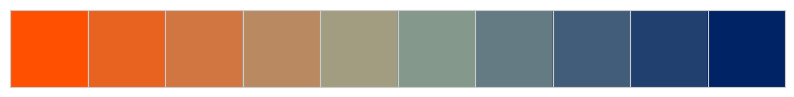

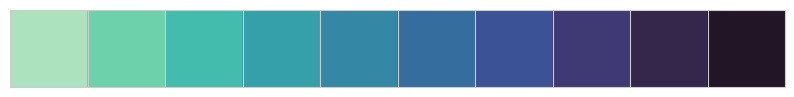

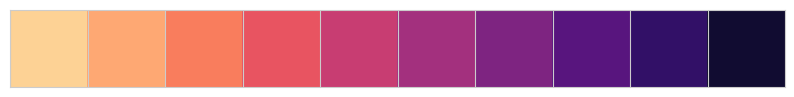

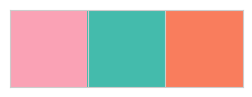

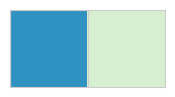

In [ ]:
# playing with colour palettes
# deciding colour palettes used later for visualization

colors = ['#FF4F00', '#97a892', '#002366']
nasa_cmap = sns.blend_palette(colors, as_cmap=True)
# A palette that uses international orange and royal blue, the two colours used by NASA for their space suites
nasa = sns.blend_palette(colors, 10)
lilac = sns.cubehelix_palette(n_colors=10, start=1.7, rot=1.00, gamma=1.00, hue=0.8, light=0.85, dark=0.4)
sns.palplot(nasa)
#sns.palplot(lilac)
mako_r = sns.color_palette('mako_r', 10)
sns.palplot(mako_r)
magma_r = sns.color_palette('magma_r', 10)
sns.palplot(magma_r)
colors = [sns.color_palette("RdPu", 10)[3], sns.color_palette('mako_r', 10)[2], sns.color_palette('magma_r', 10)[2]]
hello = sns.blend_palette(colors, 3)
sns.palplot(hello)
colors = ['#3092c1', '#d7efd1']
bello = sns.blend_palette(colors, 2)

sns.palplot(bello)

In [ ]:
# funtion to remove outliers
# defined to remove skewness from our plots 

def rem_out(df, columns):
  for column in columns:
    q1 = df[column].quantile(0.25)
    q3 = df[column].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - (1.5 * iqr)
    upper_bound = q3 + (1.5 * iqr)
    df = df[(df[column] > lower_bound) & (df[column] < upper_bound)]
    return df

## 💡 **"How do Albedo and H relate to diameter?"**<br>

1. ☄️ <strong>Albedo</strong> : Ratio of a body's brightness at zero phase angle to the brightness of a perfectly diffusing disk with the same position and apparent size as the body.
>📍 Calculation of albedo takes apparent <em>size</em> of body, <em>surface features</em> and <em>distance</em> of the body from earth into consideration
2. ☄️ <strong>H</strong> : Visual magnitude an observer would record if the asteroid were placed 1 Astronomical Unit (au) away, and 1 au from the Sun and at a zero phase angle.<br>
>📍 It gives us information of an objects <em>size</em> and <em>surface features</em> since it is calculated at standard distance.</p>

[📺 Michel van Biezen: Measuring Distance, Size, and Luminosity](https://www.youtube.com/watch?v=yfsUhOPCMaM)

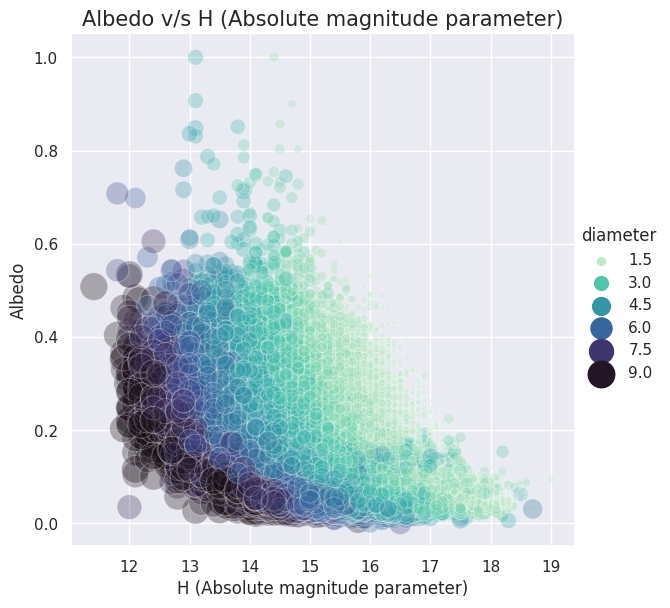

In [ ]:
sns.set_style('darkgrid')
# sampling half of the data to visualize relation between albedo and absolute magnitude parameter

df_diameter = rem_out(df, ['diameter'])

df_diameter = df_diameter.sample(frac=0.5, weights='diameter', random_state=1)
sns.relplot(x="H", y="albedo", hue="diameter", size="diameter",
            sizes=(5, 400), alpha=.3, palette='mako_r',
            height=6, data=df_diameter, legend='brief')

plt.title('Albedo v/s H (Absolute magnitude parameter)', fontsize=15)
plt.ylabel('Albedo', fontsize=12)
plt.xlabel('H (Absolute magnitude parameter)', fontsize=12)
plt.show()

Text(0.5, 1.0, 'Diameter v/s Albedo')

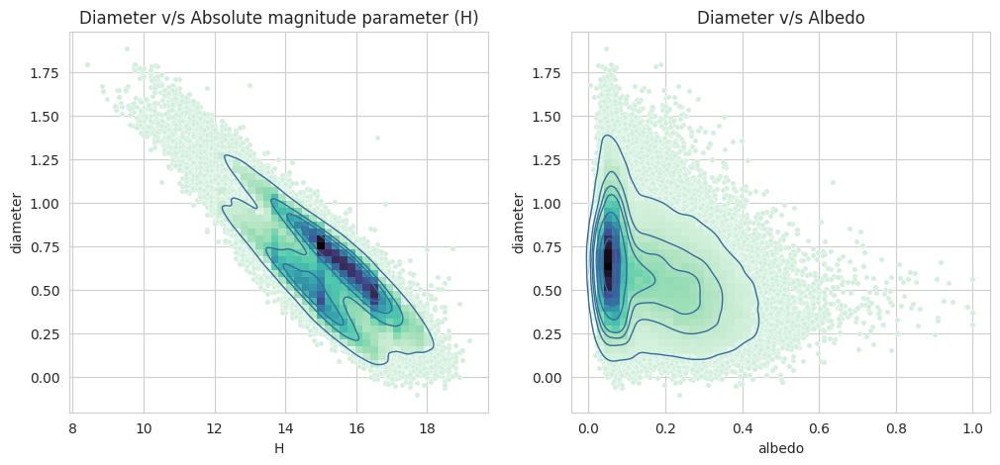

In [ ]:
sns.set_style('whitegrid')
plt.figure(figsize=(12, 5))

plt.subplot(1, 2 ,1)
sns.kdeplot(x='H', y=df['diameter'].apply(np.log10), data=df, levels=5, color="#356c9c", linewidths=1)
sns.scatterplot(x='H', y=df['diameter'].apply(np.log10), data=df, s=15, color="#d1efdc")
sns.histplot(x='H', y=df['diameter'].apply(np.log10), data=df, bins=50, pthresh=.05, cmap='mako_r')
plt.title('Diameter v/s Absolute magnitude parameter (H)', fontsize=12)

plt.subplot(1, 2 ,2)
sns.kdeplot(x='albedo', y=df['diameter'].apply(np.log10), data=df, levels=8, color="#356c9c", linewidths=1)
sns.scatterplot(x='albedo', y=df['diameter'].apply(np.log10), data=df, s=15, color="#d1efdc")
sns.histplot(x='albedo', y=df['diameter'].apply(np.log10), data=df, bins=50, pthresh=.05, cmap='mako_r')
plt.title('Diameter v/s Albedo', fontsize=12)

---
### Understanding other attributes associated to predicting diameter<br>
> 1. 🤖 **XGBoost**: Making predictions on the added difficulty dataset (albedo and H removed) using a fine tuned XGBoost regressor.
> 2. 🍋 **LIME**: Performing model interpretation on the using lime to understand the most important features apart from H and albedo that can be used to predict diameter

In [ ]:
diff_df1 = diff_df.copy()
y_diff = diff_df1.pop('diameter')
xdiff_train, xdiff_test, ydiff_train, ydiff_test = train_test_split(diff_df1, y_diff, shuffle=True, random_state=21)

# model = XGBRegressor(n_estimators=1000, max_depth=7, eta=0.1, subsample=0.7, colsample_bytree=0.8)
model = XGBRegressor(n_estimators=100, max_depth=6, eta=0.2, gamma=0.2, colsample_bytree=0.3)
model.fit(xdiff_train, ydiff_train)
pred = model.predict(xdiff_test)

xgb_MSE = mean_squared_error(pred, ydiff_test)
xgb_RMSE = mean_squared_error(pred, ydiff_test, squared=False)
xgb_MAE = mean_absolute_error(pred, ydiff_test)
print(f"MAE: {round(xgb_MAE, 4)}, MSE: {round(xgb_MSE, 4)}, RMSE: {round(xgb_RMSE, 4)}")

MAE: 1.0086, MSE: 3.2449, RMSE: 1.8014


In [ ]:
explainer = lime_tabular.LimeTabularExplainer(
    training_data=np.array(xdiff_train),
    feature_names=xdiff_train.columns,
    class_names=['diameter'],
    verbose=False,
    mode='regression'
)

In [ ]:
i = 25
exp = explainer.explain_instance(xdiff_test.iloc[47], model.predict, num_features=5)
exp.show_in_notebook(show_table=True)

📝 We can conclude that **mean motion** and  **orbital period** of an asteroid can be used to predict diameter with low error

---
## 💡 **"How do Mean motion and Orbital Period relate to diameter?"**<br>

1. ☄️ <strong>Mean motion (n)</strong> : mean motion of an object is the average angular speed at which it moves along its orbit, measured in degrees per day. Mean motion is dependent on mass of both the bodies and the semi-major axis.
>![hello](https://wikimedia.org/api/rest_v1/media/math/render/svg/5bb38a430d7a171919c95e9a65e9d713f96d08b4 "a title")
2. ☄️ <strong>Orbital period (per)</strong> : Sidereal orbital period is the orbital period in an inertial (non-rotating) frame of reference. Also dependent on sum of semi-major axes of both the bodies and the sum of mass.<br>
>![hello](https://wikimedia.org/api/rest_v1/media/math/render/svg/3e3b818e77117af84080cc6130389c9908f2fde8 "a title")

In [ ]:
fig = px.scatter(df_diameter, x="n", y="per", marginal_y="violin", color="diameter",
           marginal_x="violin", height=600, width=650, template='seaborn', title = 'Mean motion(n) v/s Orbital period(per)')

fig.show()

Text(0.5, 1.0, 'Diameter v/s Orbital period (per)')

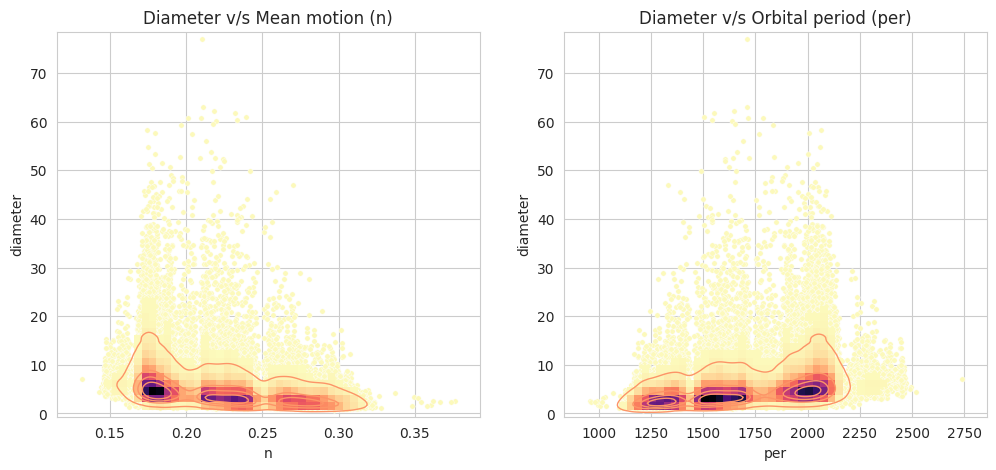

In [ ]:
# fig = px.scatter(df, x="n", y="diameter", color="diameter",
#             height=600, width=650, template='seaborn', title = 'Mean motion(n) v/s diameter')
# fig.show()

sns.set_style('whitegrid')
plt.figure(figsize=(12, 5))

plt.subplot(1, 2 ,1)
sns.kdeplot(x=df['n'], y=df['diameter'], levels=5, color="#fd9467", linewidths=1)
sns.scatterplot(x=df['n'], y=df['diameter'], s=15, color="#fcf9bb")
sns.histplot(x=df['n'], y=df['diameter'], bins=50, pthresh=.02, cmap='magma_r')
plt.title('Diameter v/s Mean motion (n)', fontsize=12)

plt.subplot(1, 2 ,2)
sns.kdeplot(x=df['per'], y=df['diameter'], levels=5, color="#fd9467", linewidths=1)
sns.scatterplot(x=df['per'], y=df['diameter'], s=15, color="#fcf9bb")
sns.histplot(x=df['per'], y=df['diameter'], bins=50, pthresh=.02, cmap='magma_r')
plt.title('Diameter v/s Orbital period (per)', fontsize=12)

In [ ]:
fig = px.scatter_3d(df, x="H", y='albedo', z="diameter", color='diameter', template='seaborn', height=500, width=600)
fig.show()
fig = px.scatter_3d(df, x="n", y='per', z="diameter", color='diameter', template='seaborn', height=500, width=600)
fig.show()

---
## ☠️ The threat posed by Near Earth Asteroids🌏 
 On analysing the data, we found *21400 NEOs* out of which *2015 are 
physically hazardous*<br>
> Near earth asteroids can be divided into three major categories:
* Aten Asteroids: <strong>a < 1 AU</strong> and <strong>q > 0.983 AU</strong> (Mostly lie within the earth's orbit)<br>
* Apollo Asteroids: <strong>a > 1 AU</strong> and <strong>q < 0.983 AU</strong> (Cross but mostly spend most of the time outside earth's orbit)<br>
* Amor Asteroids: <strong>a > 1 AU</strong> and <strong>1.017 AU < q < 0.983 AU</strong> (Mostly lie outside the earth's orbit)<br>
where <strong>a: semi-major axis</strong> and <strong>q: perihelion distance</strong><br>

> | Class    | Count |
|---------|-----|
| AMO   |  11759 | 
| APO   |  8020 | 
| ATE   |  1601| 



In [ ]:
convert_dict = {'diameter': float}
df_A = df_orig.copy()
df_A = df_A.astype(convert_dict)
df_A = df_A.loc[(df_A['class'].isin(['APO', 'ATE', 'AMO']))]
df_A = pd.get_dummies(df_A, columns = ['pha', 'neo'])

# df_A = rem_out(df_A, ['diameter'])
# df_A['pha_Y'] = df_A['pha_Y'].astype(float)
df_A['class'].value_counts()

APO    11759
AMO     8020
ATE     1601
Name: class, dtype: int64

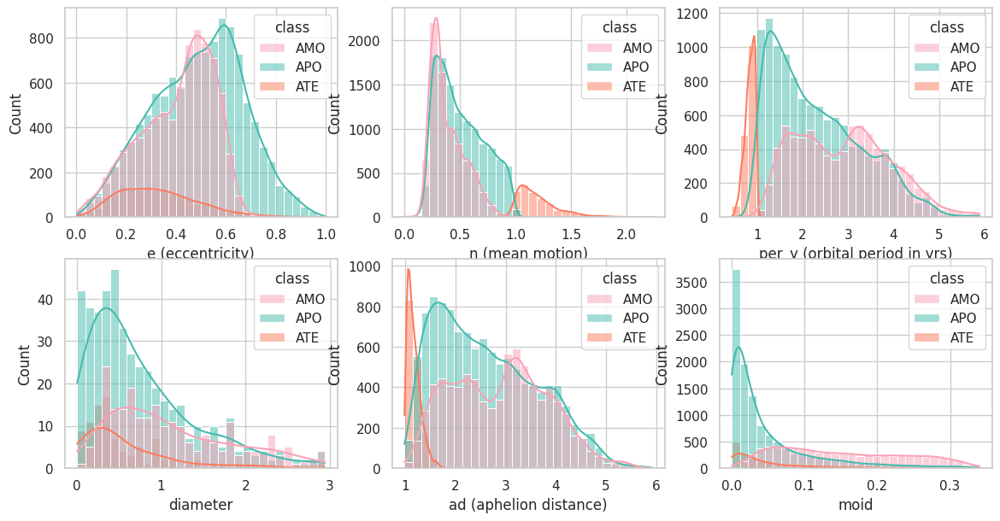

In [ ]:
sns.set_style('whitegrid')
plt.figure(figsize=(14, 7))

plt.subplot(2, 3 ,1)
sns.histplot(data = df_A, x='e',  bins=30, hue='class', kde=True, palette=hello)
plt.xlabel('e (eccentricity)')

plt.subplot(2, 3 ,2)
sns.histplot(data = df_A, x='n',  bins=30, hue='class', kde=True, palette=hello)
plt.xlabel('n (mean motion)')

plt.subplot(2, 3 ,3)
df_Ap = rem_out(df_A, ['per_y']) #removing period outliers to reduce skewness
sns.histplot(data = df_Ap, x='per_y',  bins=30, hue='class', kde=True, palette=hello)
plt.xlabel('per_y (orbital period in yrs)')

plt.subplot(2, 3 ,4)
df_Ad = rem_out(df_A, ['diameter']) #removing diameter outliers to reduce skewness
sns.histplot(data = df_Ad, x='diameter',  bins=30, hue='class', kde=True, palette=hello)
plt.xlabel('diameter')

plt.subplot(2, 3 ,5)
df_Aa = rem_out(df_A, ['ad']) #removing diameter outliers to reduce skewness
sns.histplot(data = df_Aa, x='ad',  bins=30, hue='class', kde=True, palette=hello)
plt.xlabel('ad (aphelion distance)')

plt.subplot(2, 3 ,6)
df_Am = rem_out(df_A, ['moid']) #removing diameter outliers to reduce skewness
sns.histplot(data = df_Am, x='moid',  bins=30, hue='class', kde=True, palette=hello)
plt.xlabel('moid')
# sns.despine( right=True, left=True, top=True, bottom=True)

df_neo = df_A.copy()
plt.show()

> 👾 **Aten asteroids have low eccentricities** is because they are strongly influenced by the gravitational pull of the Earth. The Earth's gravity tends to circularize the orbits of objects that are near it, causing them to have low eccentricities.

> 👾 **Aten asteroids have mean motions greater than 1** degree per day, which is relatively high compared to other asteroids and is slightly higher than the earth.<br>
This means they have a shorter orbit to complete, and therefore a higher mean motion.

> 👾 **Atens and Apollos have low moid.** Moid stands for Minimum orbit Intersection Distance. The reason for this is that both these classes cross the earth at some point. 


In [ ]:
from sklearn import preprocessing
le = preprocessing.LabelEncoder()

# Encode the 'Category' column inplace
df_B = df_A.copy()
df_B['class_encoded'] = le.fit_transform(df_B['class'])

df_B['pha_Y'] = df_B['pha_Y'].astype(float)
df_B = df_B[['diameter', 'a', 'ad', 'class', 'class_encoded', 'moid', 'pha_Y']]
df_B = df_B.sample(frac=0.01, random_state=1)
fig = px.parallel_coordinates(df_B , dimensions=['class_encoded', 'moid', 'ad','pha_Y'], color='class_encoded',
                              color_continuous_scale=px.colors.diverging.Tealrose,
                              color_continuous_midpoint=0.5, height=450, width=1100)
fig.show()
# 0: Amors 1: Apollos 2: Atens

> 🛸 **Atens show the lowest moid** (Earth Minimum orbit Intersection Distance). Only asteroids having moids less than 0.05 AU and diameter more than 140 meters can be considered physically hazardous.<br>

> 🛸 **Atens, and Apollos constitute most of the PHAs**. Rarely is an Amor classified as physically hazardous. Only **1.5% of Amors** are PHAs compared to **10% for Apollos and Atens**.


>| Class    | PHA | Count | % of class |
|---------|-----|--------|--------------|
| AMO   |  Yes | 122 | 1.5% |
|      |  No |   7898 | 
| APO   |  Yes | 1716 | 10% |
|      |  No |   10043 |
| ATE   |  Yes | 171 | 10.6%|
|      |  No |   1430 |



---



## 🔭Observing the asteroids
👀 Asteroids are observed multiple times for a few different reasons: 
> <li>To determine their orbit <br><li> Refine their orbit<br> <li> Study their physical properties<br> <li> Search for moons or companions<br>

It is an obvious fact that **far away** and **less bright** asteroids have to be observed more number of times to be studied properly. <br>
*More observations provide more information about the asteroid's orbit and position.*

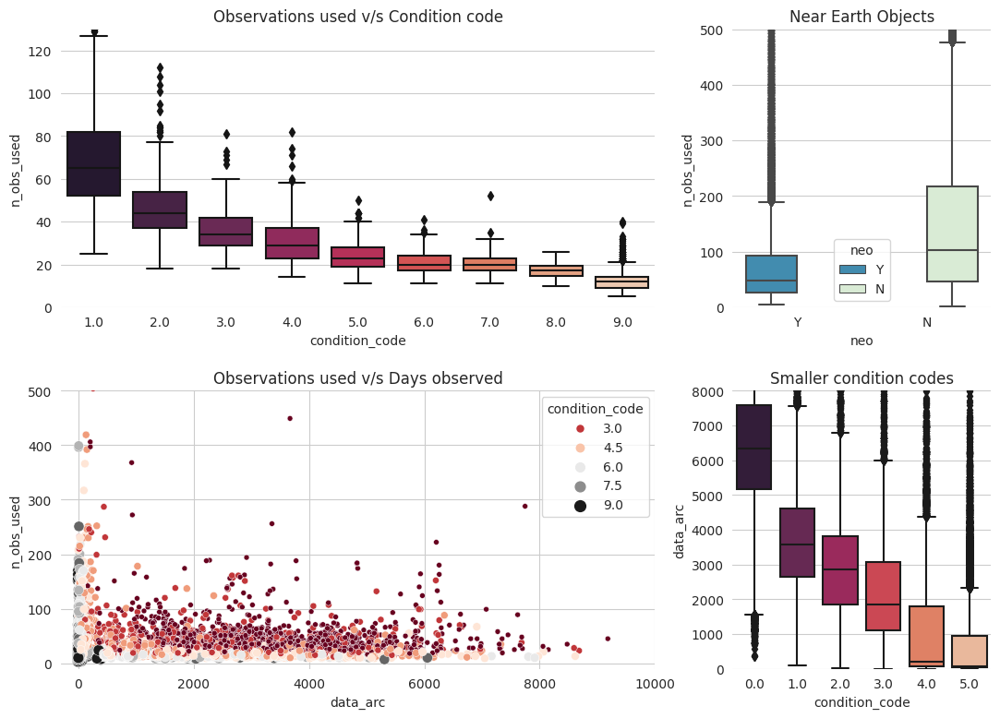

In [ ]:
sns.set_style('whitegrid')
plt.figure(figsize=(13, 9))
df_obs = rem_out(df_orig, ['n_obs_used'])

df_arc = rem_out(df_orig, ['data_arc'])
df_arc = df_arc[pd.to_numeric(df_arc['condition_code'], errors='coerce').notnull()]
df_arc['condition_code'] = df_arc['condition_code'].astype(float)

grid = plt.GridSpec(2, 3, hspace=0.3, wspace=0.3)
plt.subplot(grid[0, -1])
ax = sns.boxplot(data=df_obs, x="neo", y='n_obs_used', hue='neo', palette=bello)
ax.set(ylim=(0, 500))
plt.title('Near Earth Objects')

# Main Belt asteroids have orbits that are relatively far from the Earth, which means that they move relatively slowly across the sky. This makes them easier to track over longer periods of time, and it also means that they can be observed from multiple locations around the world, increasing the number of observations that can be made.

plt.subplot(grid[0, :-1])
df_obs = rem_out(df, ['n_obs_used'])
df_obs = df_obs.loc[(df_obs.condition_code>=1) & (df_obs.n_obs_used<=150)]
ax = sns.boxplot(data = df_obs, x= 'condition_code', y = 'n_obs_used', palette=sns.color_palette("rocket", 9))
ax.set(ylim=(0, 130))
plt.title('Observations used v/s Condition code')

plt.subplot(grid[1, :-1])
ax = sns.scatterplot(df_arc.loc[(df_arc['condition_code']>1)].sample(frac=0.1, random_state=1), x='data_arc', y='n_obs_used', hue='condition_code', size='condition_code', palette='RdGy')
ax.set_ylim(top=500, bottom=-10)
ax.set_xlim(left=-300, right=10000)
plt.title('Observations used v/s Days observed')

plt.subplot(grid[1, -1])
ax = sns.boxplot(data = df_arc.loc[(df_arc['condition_code']<6)], x= 'condition_code', y = 'data_arc', palette=sns.color_palette("rocket", 6))
ax.set_ylim(top=8000, bottom=0)
plt.title('Smaller condition codes')

# plt.subplot(grid[1, 2])
# ax = sns.boxplot(data = df_arc.loc[(df_arc['condition_code']>5)], x= 'condition_code', y = 'data_arc', palette=sns.color_palette("Greys", 4))
# ax.set_ylim(top=80, bottom=0)
# plt.ylabel('')
# plt.title('Larger condition codes')

sns.despine( right=True, left=True, top=True, bottom=True)

> 🔭 **Condition Code (Orbit condition code):** integer between 0 and 9 indicating how well an object's orbit is known on a logarithmic scale. Asteroids having a low condition code have difficult to determine orbits and hence need to be observed  higher number of times. 

> <img src="https://upload.wikimedia.org/wikipedia/commons/7/70/NEA-sizes-vs-uncertainties-compact.PNG" 
     height="300" />

> 🔭 **Relation between observations and NEOs:** It is visible from the graph above that the number of observations used for far away ateroids are dar more than NEOs. NEO's smaller orbit and low distance from the earth make them easy to keep track of.

> 🔭 **Observations v/s data_arc:** In the scatterplot above, asteroids with higher condition codes either have low data arc (number of days for which the data was collected) or low numner of observations. They don't need both for being studied properly.

<Axes: xlabel='Count', ylabel='n_obs_used'>

<Figure size 1300x400 with 0 Axes>

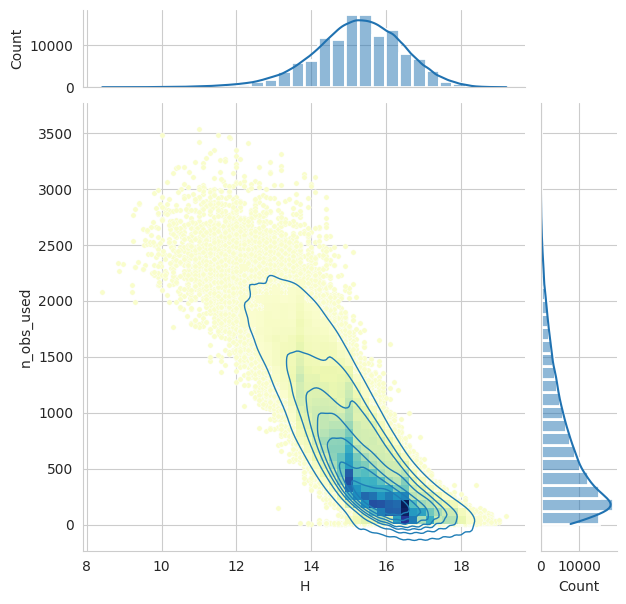

In [ ]:
sns.set_style('whitegrid')

plt.figure(figsize=(13, 4))
h = sns.JointGrid(marginal_ticks=True)
# h.ax_joint.set(ylim=(0, 4000))
x, y= df['H'], df['n_obs_used']
sns.scatterplot(x=x, y=y, data=df, s=15, color="#f9fdcb", ax=h.ax_joint)
#sns.regplot(x=x, y=y, data=df, color="#9a9a9a", ax=h.ax_joint, scatter=False, truncate=True)
sns.kdeplot(x=x, y=y, data=df, levels=8, color="#1f7db6", linewidths=1 , ax=h.ax_joint)
sns.histplot(x=x, y=y, data=df, bins=50, pthresh=.05, cmap='YlGnBu', ax=h.ax_joint)
sns.histplot(x=x, linewidth=2, ax=h.ax_marg_x, bins=30, color="#2072b1", kde=True)
sns.histplot(y=y, linewidth=2, ax=h.ax_marg_y, bins=30, color="#2072b1", kde=True)

> 🌌 The plot between **'H (Absolute parameter)'** and **'Number of observations used'** presents a clear linear relation between the brightness of an asteroid and the number of observations required to extract information about them.
---

## Rankings🥇🥈🥉
> Taking a look at our massive outliers

In [ ]:
def display_side_by_side(*args):
    html_str = ' '
    for df in args:
        html_str += df.to_html()
    display_html(
        html_str.replace('table','table style="display:inline"'), 
        raw=True
    )
    
convert_dict = {'diameter': float}
df_rank = df_orig.copy()
df_rank = df_rank.astype(convert_dict)

,diameter,class
0,0.0025,APO
1,0.0080,APO
2,0.0080,APO
3,0.0130,APO
4,0.0150,APO
5,0.0180,APO
6,0.0180,APO
7,0.0190,APO
8,0.0230,ATE
9,0.0240,APO


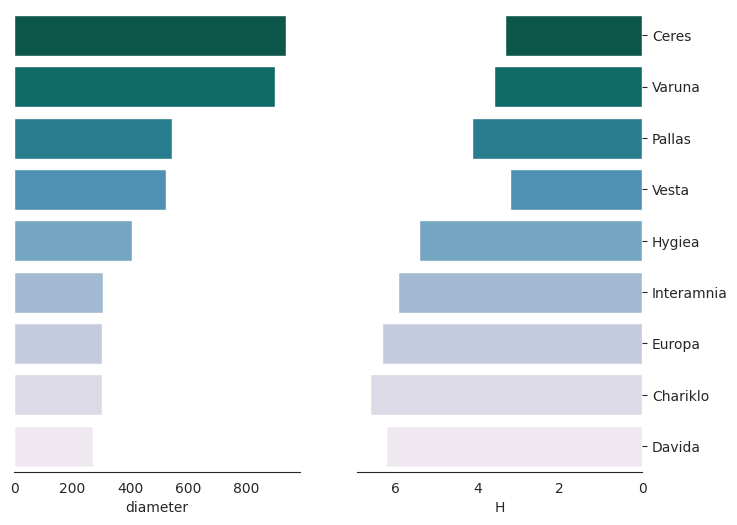

In [ ]:
sns.set_style('white')
plt.figure(figsize=(8.1, 6))

lowDia = df_rank[['diameter','class']].sort_values(by='diameter').head(10).reset_index()
lowDia = lowDia.drop(columns='index')
topDia = df_rank[['name', 'diameter', 'H', 'moid', 'per_y', 'class', 'spec_B']].sort_values(by='diameter', ascending=False).head(10).reset_index()
topDia = topDia.drop(columns='index')
display_side_by_side(lowDia, topDia)
# accidentally found out that the 9 out of 10 smallest asteroids belong to Apollos
# 7 out of 10 largest asteroids belong to the Main belt
# 4 out of the 10 largest asteroids are carbonaceous

plt.subplot(1, 2, 1)
sns.barplot(data=topDia, y='name', x='diameter', palette='PuBuGn_r')
plt.yticks([])
plt.ylabel('')

plt.subplot(1, 2, 2)
ax = sns.barplot(data=topDia, y='name', x='H', palette='PuBuGn_r')
ax.yaxis.set_label_position("right")
ax.yaxis.tick_right()
sns.despine( right=True, left=True)
plt.ylabel('')
plt.xlim(plt.xlim()[::-1])
plt.show()

#SMALLEST ASTEROIDS                        #LARGEST ASTEROIDS

☄️**Ceres** was the first asteroid ever found<br>
☄️**Varuna** is a TNO (TransNeptunian Object) about to be declared a dwarf planet
[Know more](https://www.tumblr.com/tosatisfymystarryheart/170593223986/varuna-the-asteroid-dwarf-planet)<br>
> 💡 **Did you know?** : About 60% of the main belt mass is contained in the four largest asteroids: **Ceres, Vesta, Pallas, and Hygiea**.
---

## Studying the composition⚛️
> 🧪**[C-group](https://en.wikipedia.org/wiki/C-type_asteroid#C-group_asteroids)** of carbonaceous objects includes the [C-type asteroid](https://en.wikipedia.org/wiki/C-type_asteroid), the most "standard" of the non-B carbonaceous objects. Cg, Ch, and Cgh-types are somewhat related to the Tholen [G-type](https://en.wikipedia.org/wiki/G-type_asteroid). The "h" stands for "hydrated".

> 🧪**S-group** of silicaceous (stony) objects includes the most common [S-type asteroid](https://en.wikipedia.org/wiki/S-type_asteroid). There are five classes, Sa, Sq, Sr, Sk, and Sl that transition between plain the S-type and the other corresponding types in this group.

> 🧪**X-group** of mostly metallic objects. This includes the most common [X-type asteroids](https://en.wikipedia.org/wiki/X-type_asteroid) as well as the M, E, or P-type as classified by Tholen. The Xe, Xc, and Xk are transitional types between the plain X- and the corresponding [E](https://en.wikipedia.org/wiki/E-type_asteroid), [C](https://en.wikipedia.org/wiki/C-type_asteroid) and [K](https://en.wikipedia.org/wiki/K-type_asteroid) classes.

>| Group   | Count | 
|---------|-----|
| S   |  728 | 
|  C    |  352 | 
| X   |  289 | 
| Others   |  297 | 


In [ ]:
# spec_B and spec_T contain 34 and 131 classes respectively
# top 5 frequent categories: S C Ch X Sq
# Main groups:
  # C group (C, Ch, Cb, Cg, Cgh) carbonaceous
  # S group (S, Sa, Sl, Sk ,Sr, S:, Sq:, S(IV)) silicaceous (stony)
  # X group (X, Xc, Xk, Xe, X:) metallic
# We took all the 34 classes and grouped them into C, S, X and other groups

df_spec = df_orig.copy()

convert_dict = {'diameter': float}
df_spec = df_spec.astype(convert_dict)
df_spec['spec_B'] = df_spec['spec_B'].replace(['C', 'Ch', 'Cb', 'Cg', 'Cgh'], 'C')
df_spec['spec_B'] = df_spec['spec_B'].replace(['S', 'Sa', 'Sl', 'Sk' ,'Sr', 'S:', 'Sq', 'Sq:', 'S(IV)'], 'S')
df_spec['spec_B'] = df_spec['spec_B'].replace(['X', 'Xc', 'Xk', 'Xe', 'X:'], 'X')
df_spec['spec_B'] = df_spec['spec_B'].replace(['B', 'V', 'L', 'K', 'Q', 'T', 'A', 'Ld', 'D', 'O', 'R', 'U', 'C:', 'K:', 'V:'], 'others')

df_spec = df_spec.loc[df_spec['spec_B'].notnull()]
df_specfull=df_spec.copy()
df_spec = df_spec.loc[df_spec['spec_B'].isin(['C', 'S', 'X'])]
print("spec_B(SMASSII) classes: ", df_orig.spec_B.unique(), "\n")
df_specfull['spec_B'].value_counts()

spec_B(SMASSII) classes:  ['C' 'B' 'Sk' 'V' 'S' nan 'L' 'Ch' 'X' 'Sl' 'Xk' 'Cb' 'Sq' 'Cgh' 'Xc' 'Sa'
 'Xe' 'K' 'T' 'Cg' 'Ld' 'A' 'D' 'R' 'Sr' 'Q' 'O' 'U' 'S:' 'S(IV)' 'Sq:'
 'X:' 'K:' 'C:' 'V:'] 



S         728
C         352
others    297
X         289
Name: spec_B, dtype: int64

In [ ]:
print("Number of classes in spec_B: ", df_orig.spec_B.value_counts().sort_values(ascending=False).count())
print("Number of classes in spec_T: ", df_orig.spec_T.value_counts().sort_values(ascending=False).count(), "\n")
# spec_B and spec_T contain 34 and 131 classes respectively
# Therefore I am not going to one-hot encode the values
print("spec_B(SMASSII) classes: ", df_orig.spec_B.unique(), "\n")
print("spec_T(Tholen) classes: ", df_orig.spec_T.unique(), "\n")
print("Asteroid orbital classes: ", df_orig['class'].unique())

Number of classes in spec_B:  34
Number of classes in spec_T:  131 

spec_B(SMASSII) classes:  ['C' 'B' 'Sk' 'V' 'S' nan 'L' 'Ch' 'X' 'Sl' 'Xk' 'Cb' 'Sq' 'Cgh' 'Xc' 'Sa'
 'Xe' 'K' 'T' 'Cg' 'Ld' 'A' 'D' 'R' 'Sr' 'Q' 'O' 'U' 'S:' 'S(IV)' 'Sq:'
 'X:' 'K:' 'C:' 'V:'] 

spec_T(Tholen) classes:  ['G' 'B' 'S' 'V' 'C' 'M' 'E' 'FC' 'P' 'CG' 'X' 'CU' 'CF' 'XC' 'CP' 'BU'
 'TDG' 'MU' 'T' 'GC' 'DCX' 'ST' 'CX' 'SU' 'SR' 'CPF' 'F' 'GU' 'I' nan
 'XFC' 'STU' 'CD' 'GC:' 'C:' 'XC:' 'DCX:' 'BCU' 'A' 'SCTU' 'CX:' 'DU' 'PC'
 'D' 'BFU::' 'CXF' 'FP' 'CSGU' 'R' 'DP' 'QSV' 'BFC' 'PD' 'DT' 'DX' 'F:'
 'X:' 'TD' 'CSU' 'CB' 'FCX' 'FXU:' 'CGU' 'DU:' 'XD:' 'XCU' 'CDX:' 'CFB:'
 'XDC' 'PCD' 'TSD' 'FCX:' 'XB:' 'SD' 'CD:' 'CP:' 'DX:' 'STGD' 'CGSU' 'FX:'
 'XF' 'SC' 'CPU:' 'XD' 'DXCU' 'XFU' 'GS:' 'CBU:' 'CTGU:' 'FCB' 'XB' 'DTU'
 'CB:' 'FC:' 'FU' 'PF' 'CFU:' 'XSC' 'DTU:' 'CGTP:' 'FCU' 'MU:' 'PDC' 'BC:'
 'FX' 'XU' 'BCF' 'P:' 'PU' 'XSCU' 'AS' 'G:' 'CBU' 'FBCU::' 'AU:' 'XFCU'
 'Q' 'SQ' 'SMU' 'BU:' 'TCG:' 'DSU:' 'CFXU' 'SG' 'BC

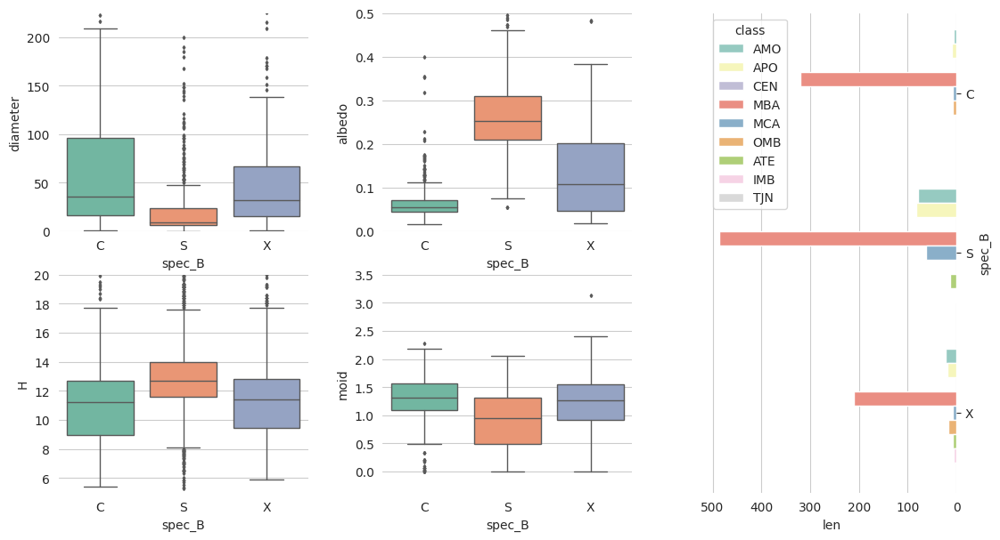

In [ ]:
plt.figure(figsize=(13, 7))
sns.set_style('whitegridw')

grid = plt.GridSpec(2, 3, hspace=0.2, wspace=0.3)

plt.subplot(grid[0, 0])
ax = sns.boxplot(df_spec, x='spec_B', y='diameter', palette='Set2', linewidth=1, fliersize=2)
ax.set_ylim(top=225, bottom=0)

plt.subplot(grid[0, 1])
ax = sns.boxplot(df_spec, x='spec_B', y='albedo', palette='Set2', linewidth=1, fliersize=2)
ax.set_ylim(top=0.5, bottom=0)

plt.subplot(grid[1, 0])
ax = sns.boxplot(df_spec, x='spec_B', y='H', palette='Set2', linewidth=1, fliersize=2)
ax.set_ylim(top=20, bottom=5)

plt.subplot(grid[1, 1])
ax = sns.boxplot(df_spec, x='spec_B', y='moid', palette='Set2', linewidth=1, fliersize=2)
ax.set_ylim(top=3.5)

plt.subplot(grid[:, 2])
df_sc = df_spec.groupby(['spec_B', 'class']).e.agg([len]).reset_index()
# df_sc
ax = sns.barplot(df_sc, y='spec_B', x='len', hue='class', palette='Set3')
plt.xlim(plt.xlim()[::-1])
ax.yaxis.set_label_position("right")
ax.yaxis.tick_right()

sns.despine( right=True, left=True, top=True, bottom=True)

In [ ]:
df_orig.loc[df_orig['neo']=='Y'].shape # a total of 21400 neos in the data

(21400, 31)

In [ ]:
class_counts = df_orig['class'].value_counts()
class_counts

MBA    747420
OMB     24715
IMB     17552
MCA     17354
APO     11759
AMO      8020
TJN      7385
TNO      3310
ATE      1601
CEN       488
AST        84
IEO        20
HYA         4
PAA         2
Name: class, dtype: int64

In [ ]:
dia_of_big4 = df_orig.loc[df_orig.name.isin(['Vesta', 'Pallas', 'Ceres', 'Hygiea'])]['diameter'].astype(float).sum()
dia_of_mba = df_orig.loc[df_orig['class']=='MBA']['diameter'].astype(float).sum()
print('combined diameter (km) of Vesta, Pallas, Ceres, and Hygiea: ', dia_of_big4)
print('combined diameter (km) of the rest of the asteroid belt: ', dia_of_mba - dia_of_big4) 

vol_big4 = (4/3)*math.pi*pow(dia_of_big4/2, 3)
vol_mba = (4/3)*math.pi*pow(dia_of_mba/2, 3)
density_ratio = vol_big4/(vol_mba-vol_big4*0.6)
print('combined volume (km^3) of Vesta, Pallas, Ceres, and Hygiea: ', vol_big4)
print('combined volume (km^3) of the rest of the asteroid belt', vol_mba)
print(density_ratio)
print('The big 4 are, on average', 1/(density_ratio), 'times denser than the rest of the asteoid belt')
# 💡 Did you know? : About 60% of the main belt mass is contained in the four largest asteroids: Ceres, Vesta, Pallas, and Hygiea.
# 1) calculated volumes of big4 and the rest of MBA using diameter
# 2) calculated what percentage of denisty of MBA is the density of big4 using density_mba = x * density_big4 (density calculated using mass and volume)
# 3) 1/(density_ratio*100) to get what times of 

combined diameter (km) of Vesta, Pallas, Ceres, and Hygiea:  2416.92
combined diameter (km) of the rest of the asteroid belt:  639181.861
combined volume (km^3) of Vesta, Pallas, Ceres, and Hygiea:  7392399837.839136
combined volume (km^3) of the rest of the asteroid belt 1.3828950202123914e+17
5.34559743645945e-08
The big 4 are, on average 18706982.93102913 times denser than the rest of the asteoid belt


<Axes: xlabel='per_y', ylabel='a'>

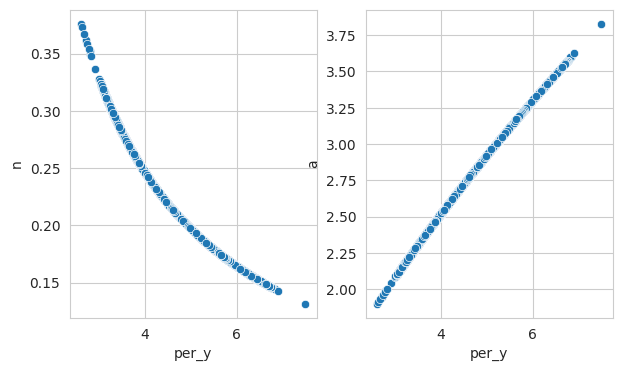

In [ ]:
plt.figure(figsize=(7, 4))
# Mean motion (n)(angular velocity required to complete one orbit) vs Orbital period (in years) 
# The graph looks too good to be true
# This is because mean motion is not the actual orbital speed of the body 
plt.subplot(1,2,1)
sns.scatterplot(x=df.per_y, y=df.n)

plt.subplot(1,2,2)
sns.scatterplot(x=df.per_y, y=df.a)
# Kepler's 3rd law of planetary motion states, the square of the periodic time is proportional to the cube of the mean distance(semi major axis)
# formula for n is given by sqrt(G(M+m)/(a^3)). This equation is derived from keplers law. M>>m, therefore, keplers law is constant for all small bodies.

## Distributions and eccentricies💫

In [ ]:
def plot_subplots(df, columns=None):
    plt.figure(figsize=(13, 13))
    if columns is None:
        columns = df.columns
    for i, col in enumerate(columns):
      plt.subplot(6, 4, i+1)
      plt.hist(df[col])
      plt.title(col)
    plt.subplots_adjust(left=0.1,
                    bottom=0.1,
                    right=0.9,
                    top=0.9,
                    wspace=0.4,
                    hspace=0.4)

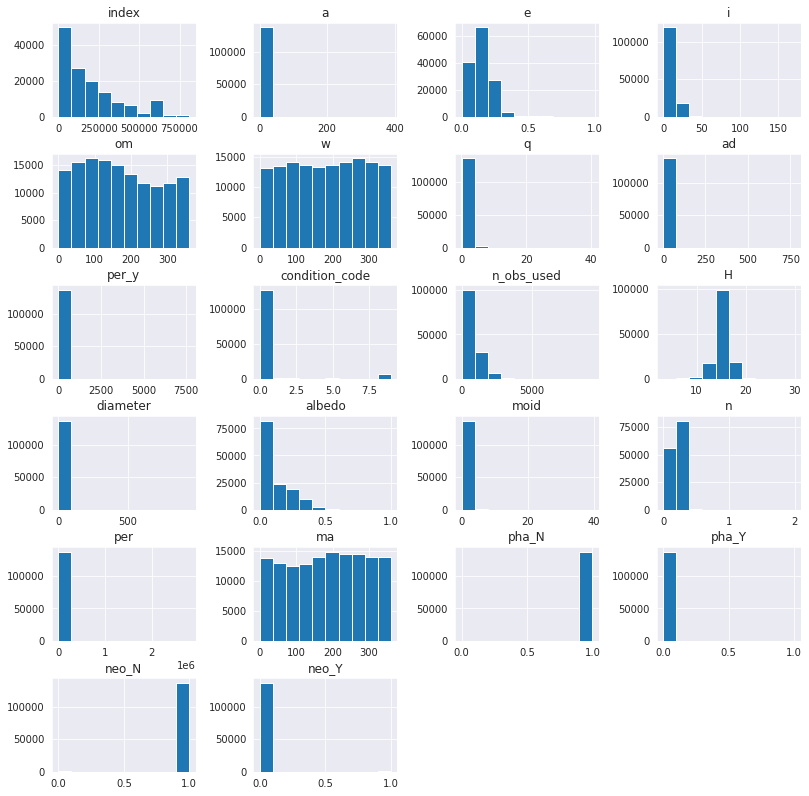

In [ ]:
plot_subplots(df)

In [ ]:
def e_grp(e):
  if e==0:
    return 'circle'
  if e==1:
    return 'parabola'
  if e>0 and e<1:
    return 'ellipse'
  if e>1:
    return 'hyperbola'

,name,a,e,i,om,w,q,ad,per_y,data_arc,condition_code,n_obs_used,H,neo,pha,diameter,extent,albedo,rot_per,GM,BV,UB,IR,spec_B,spec_T,G,moid,class,n,per,ma,e_grp
0,Ceres,2.769165,0.076009,10.594067,80.305532,73.597694,2.558684,2.979647,4.608202,8822.0,0,1002,3.34,N,N,939.4,964.4 x 964.2 x 891.8,0.090,9.07417,62.6284,0.713,0.426,NaN,C,G,0.12,1.59478,MBA,0.213885,1683.145708,77.372096,ellipse
1,Pallas,2.772466,0.230337,34.836234,173.080063,310.048857,2.133865,3.411067,4.616444,72318.0,0,8490,4.13,N,N,545,582x556x500,0.101,7.81320,14.3000,0.635,0.284,NaN,B,B,0.11,1.23324,MBA,0.213503,1686.155999,59.699133,ellipse


In [ ]:
df['e_grp'] = df['e'].apply(e_grp)
df['e_grp'].value_counts()

ellipse      839700
circle            8
hyperbola         4
parabola          2
Name: e_grp, dtype: int64

---

# 👾Playing around

## Feature Engineering
We created mulptiple features from existing ones to analyse any performance gains.
We perform the following methods in feature engineering:
1. Calculation of estimated  diameter (refer: [Asteroid Size Estimator](https://cneos.jpl.nasa.gov/tools/ast_size_est.html)[link text](https://))
2. Taking log transformation of important variables
3. Clustering important variables to identify groups in data

<h3 align="center"><B>Looking for Correlations</B></h3>

In [ ]:
# A correlation of 1 suggests that the variable increases when diameter increases (directly proportional)
# -1 suggests that the variable decreases when diameter increases (inversely proportionla)
# 0 suggests no relation
corr_matrix = df.corr()
corr_matrix["diameter"].sort_values(ascending=False)

diameter          1.000000
a                 0.506848
per               0.504927
per_y             0.504927
moid              0.460369
q                 0.455477
ad                0.429045
n_obs_used        0.370524
i                 0.120294
neo_N             0.030481
pha_N             0.013337
ma                0.012584
om                0.003346
w                 0.001231
pha_Y            -0.013337
neo_Y            -0.030481
e                -0.096069
condition_code   -0.210460
albedo           -0.261109
index            -0.368113
level_0          -0.377092
n                -0.488588
H                -0.698998
Name: diameter, dtype: float64

In [ ]:
def make_mi_scores(X, y):
    mi_scores = mutual_info_regression(X, y, random_state=0)
    mi_scores = pd.Series(mi_scores, name="MI Scores", index=X.columns)
    mi_scores = mi_scores.sort_values(ascending=False)
    return mi_scores

def corr_values(df):
    corr = df.corr()['diameter']
    corr = corr.apply(np.absolute)
    corr = corr.sort_values(ascending=False)
    corr = corr[1:]
    return corr

def plot_mi_scores(scores, palette):
    scores = scores.sort_values(ascending=False)
    width = np.arange(len(scores))
    ticks = list(scores.index)
    # plt.barh(width, scores)
    sns.barplot(x=scores, y=ticks, palette = palette)
    plt.yticks(width, ticks)

def plot_corr_scores(scores, palette):
    scores = scores.sort_values(ascending=False)
    width = np.arange(len(scores))
    ticks = list(scores.index)
    sns.barplot(x=scores, y=ticks, palette = palette)
    plt.yticks(width, ticks)

Here, we used **MI scores** to find relations between variables:
> **Mutual information** is a lot like correlation in that it measures a relationship between two quantities. The advantage of mutual information is that it can detect any kind of relationship, while correlation only detects linear relationships.

> Mutual information describes relationships in terms of *uncertainty*. The mutual information (MI) between two quantities is a measure of the extent to which knowledge of one quantity reduces uncertainty about the other. 

Text(0.5, 1.0, 'Asolute correlation after feature engineering')

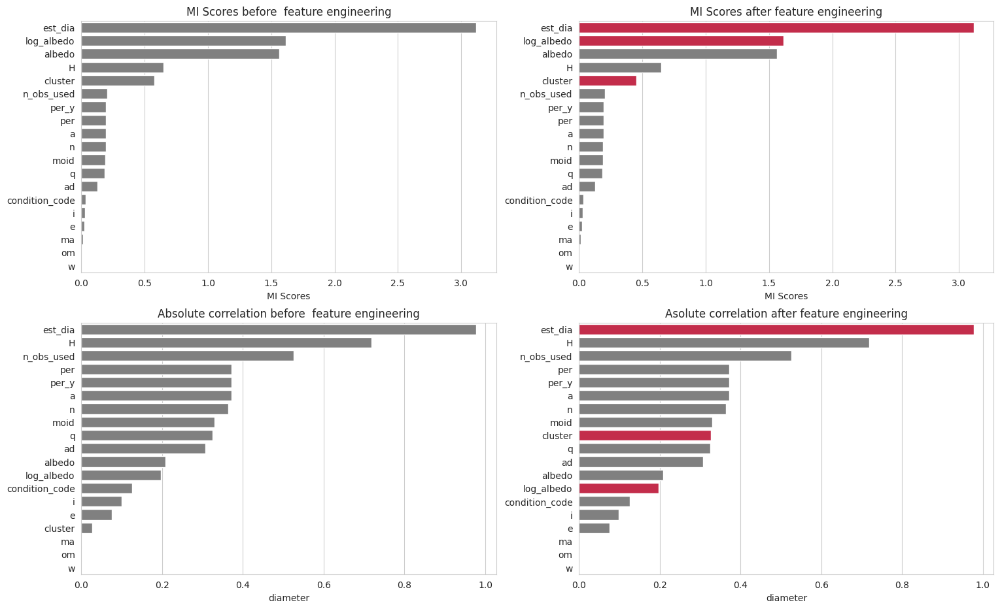

In [ ]:
# importing cleaned dataset
# df = pd.read_csv('/content/drive/MyDrive/Notebooks/Asteroid-Diameter-main/asteroid_final.csv', low_memory=False)

# plt.suptitle in crimson
X = df.copy()
y = X.pop('diameter')
plt.figure(figsize=(18, 11))
plt.subplot(2, 2, 1)
mi_scores = make_mi_scores(X, y)
palette_dict = {x: 'gray' for x in mi_scores.index}
plot_mi_scores(mi_scores, palette_dict)
plt.title("MI Scores before  feature engineering")

plt.subplot(2, 2, 3)
corr_scores = corr_values(df)
palette_dict = {x: 'gray' for x in corr_scores.index}
plot_corr_scores(corr_scores, palette_dict)
plt.title("Absolute correlation before  feature engineering")


# feature engineering
df['log_albedo'] = df['albedo'].apply(np.log10)
## calculating estimated diameter
df['est_dia'] = pow(10, 3.1236 - 0.5*df['log_albedo'] - 0.2*df['H'])

##clustering
# forming a cluster of H and albedo, our most important variables in predicting diameters
# We group them into 20 different clusters
X1 = df[['albedo', 'H']]
kmeans = KMeans(n_clusters=20, n_init='auto')
df["cluster"] = kmeans.fit_predict(X1)
df["cluster"] = df["cluster"].astype("float")

plt.subplot(2, 2, 2)
X = df.copy()
y = X.pop('diameter')
mi_scores = make_mi_scores(X, y)
palette_dict = {x: 'gray' for x in mi_scores.index}
palette_dict['est_dia'] = 'crimson'
palette_dict[ 'log_albedo'] = 'crimson'
palette_dict[ 'cluster'] = 'crimson'
plot_mi_scores(mi_scores, palette_dict)
plt.title("MI Scores after feature engineering")


plt.subplot(2, 2, 4)
corr_scores = corr_values(df)
palette_dict = {x: 'gray' for x in corr_scores.index}
palette_dict['est_dia'] = 'crimson'
palette_dict[ 'cluster'] = 'crimson'
palette_dict[ 'log_albedo'] = 'crimson'
plot_corr_scores(corr_scores, palette_dict)
plt.title("Asolute correlation after feature engineering")

# the resultant 'df' from running this cell will have extra features: est_dia, log_albedo, cluster (a cluster of albedo and H)

In [ ]:
# Registering model as an artifact in wandb
model, MSE, RMSE, MAE  = base_tree(df)
print(MSE, RMSE, MAE)
# pickle.dump(model, open(os.path.join(wandb.run.dir, "BaseTreeBeforeFeatureEngineering.pkl"), "wb"))
with open('BaseTreeBeforeFeatureEngineering.pkl', 'wb') as f:
    pickle.dump(model, f)

model_artifact = wandb.Artifact(
    name="BaseTreeBeforeFeatureEngineering",
    type="model",
    description="BeforeFeatureEngineering", 
)

model_artifact.add_file('BaseTreeBeforeFeatureEngineering.pkl')
model_artifact.add_reference('file:///content/drive/MyDrive/Notebooks/Asteroid-Diameter-main/asteroid_final.csv')
wandb.log_artifact(model_artifact)

1.7239452999382008 1.3129909748121655 0.9038855268851629


In [ ]:
model, MSE, RMSE, MAE  = base_reg(df)
print(MSE, RMSE, MAE)

pickle.dump(model, open(os.path.join(wandb.run.dir, "BaseRegBeforeFeatureEngineering.pkl"), "wb"))
artifact = wandb.Artifact("BaseRegBeforeFeatureEngineering", type="model")
artifact.add_file('BaseRegBeforeFeatureEngineering.pkl')
wandb.log_artifact(artifact)

3.0567080839205065 1.7483443836728811 0.9719973822688964


In [ ]:
run.finish()

In [ ]:
pred = df['est_dia']

In [ ]:
#final metrics and performance changes

## added difficulty dataset
# 4.901928981341403 2.2140300317162374 1.3591464036100258
## Before feature engineering
# Tree: 1.7239452999382008 1.3129909748121655 0.9038855268851629
# Reg: 3.0567080839201184 1.7483443836727701 0.9719973822690965
## after feature engineering
# Tree: 0.6580567500481646 0.8112069711535796 0.47536620388980483
# Reg: 0.48372143847612364 0.69550085440359 0.38966331177368924
# the regression model outperforms the tree after feature engineering

# directly calculating error between estimated diameter and actual diameter
# 0.5806433068831751 0.7619995451987981 0.44264185419048624
# performs slightly better than tree and worse than regression

## Training on estimated diameter and spectral classes 
We make a dataset of 1357 rows containing spectral taxonomic type B (spec_B) and the estimated diameter feature we engineered earlier. Estimated diameter has some uncertainties associated with it.
* 0.5 mag for H.
* Assumed from spectral types in the case of albedo.<br>
📌Spectral types --> Assumed compostition of an asteroid --> Uncertainty in albedo 

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Notebooks/Asteroid-Diameter-main/Asteroid_Updated.csv', low_memory=False)

df = df.dropna(subset=["diameter", "spec_B", "H", "albedo"]) # Removing rows with null diameter 
df = df[pd.to_numeric(df['diameter'], errors='coerce').notnull()] # Removing non numeric values
dfnum = df[["diameter", "H", "albedo"]].astype(float)
dfcat = df["spec_B"]
df = pd.concat([dfnum, dfcat], axis=1)
df = df.reset_index() # Resetting dataframe indexes
df = df.drop(['index'], axis=1)

label_encoder = preprocessing.LabelEncoder()
df['spec_B']= label_encoder.fit_transform(df['spec_B'])
df = df[['spec_B', 'H', 'albedo', 'diameter']]
df['log_albedo'] = df['albedo'].apply(np.log10)
df['est_dia'] = pow(10, 3.1236 - 0.5*df['log_albedo'] - 0.2*df['H'])
df = df.dropna(subset=['est_dia'])
df = df[['spec_B','est_dia', 'diameter']]

59.05637945811977 7.684814861668417 2.7748725986446745


In [ ]:
# 2.774 no model
# 3.389 without spec_B LR
# 3.402 with spec_B LR
X = df.copy()
X.pop("spec_B")
y = X.pop("diameter")

# Train and score baseline model
baseline = LinearRegression()
baseline_score = cross_val_score(
    baseline, X, y, cv=5, scoring="neg_mean_absolute_error"
)
baseline_score = -1 * baseline_score.mean()

print(f"MAE Baseline Score: {baseline_score:.4}")

MAE Baseline Score: 3.389


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1357 entries, 0 to 547421
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   spec_B    1357 non-null   int64  
 1   est_dia   1357 non-null   float64
 2   diameter  1357 non-null   object 
dtypes: float64(1), int64(1), object(1)
memory usage: 42.4+ KB


## Isolation forests🌲🌳
For removing outliers->
> As the name suggests, the Isolation Forest is a *tree-based anomaly detection algorithm*. It uses an unsupervised learning approach to detect unusual data points which can then be removed from the training data. The re-training of the model on a data set with the outliers removed generally sees performance increase.


Baseline tree model (without any outliers removed)

In [ ]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import train_test_split

df1 = df.copy()
ybase = df1.pop('diameter')
xb_train, xb_test, yb_train, yb_test = train_test_split(df1, ybase, shuffle=True, random_state=21)

model = DecisionTreeRegressor(random_state=0, max_depth= 4)
model.fit(xb_train, yb_train)
pred = model.predict(xb_test)
pred

array([3.74399215, 3.74399215, 3.74399215, ..., 7.27357196, 3.74399215,
       2.70454559])

In [ ]:
Decision_treeMSE = mean_squared_error(pred, yb_test)
Decision_treeRMSE = mean_squared_error(pred, yb_test, squared=False)
Decision_treeMAE = mean_absolute_error(pred, yb_test)
print(Decision_treeMSE)
print(Decision_treeRMSE)
print(Decision_treeMAE)

12.423321413384977
3.524673234980085
1.5729737519407188


Removing outliers<br> ---> Using IQR

In [ ]:
def remove_outliers_iqr(df, columns):
  for column in columns:
      q1 = df[column].quantile(0.25)
      q3 = df[column].quantile(0.75)
      iqr = q3 - q1
      lower_bound = q1 - (1.5 * iqr)
      upper_bound = q3 + (1.5 * iqr)
      df = df[(df[column] > lower_bound) & (df[column] < upper_bound)]
  return df

In [ ]:
cols = ['diameter', 'albedo', 'H', 'e', 'om', 'w'] 
df = remove_outliers_iqr(df, cols)
df = df.reset_index()

---> Using Isolation Forests

In [ ]:
contamination = 0.05
iso_model = IsolationForest(contamination=contamination, n_estimators=1000)
#yhat = iso_model.fit_predict(diff_df)
yhat = iso_model.fit_predict(df)

/usr/local/lib/python3.8/dist-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(


In [ ]:
# select all rows that are not outliers
mask = yhat != -1
#diff_df = diff_df.iloc[mask]
df = df.iloc[mask]

In [ ]:
# Comparative results

#size of original dataset: (839714, 31)
#Base performance (137635, 22)
## MSE: 7.727718229808534
## RMSE: 2.7798773767575673
## MAE: 1.391037382556615

# IQR on some columns (122813, 23)
## MSE: 0.6261154383568618
## RMSE: 0.7912745657209398
## MAE: 0.6197327458656555

# base dataset(contamination=0.05)
## isolates samples from others (anomaly detection) using random forests
## Doesn't care if data is categorical, numerical, multi-dimensional, no scaling (as RF's are used)
## MSE 1.8235926550814034
## RMSE 1.350404626429206
## MAE 0.9414930914722286

# added difficulty dataset (contamination=0.05) (FRESH)
## MSE 12.423321413384977
## RMSE 3.524673234980085
## MAE 1.5729737519407188


Baseline regression model (without log normalization)

In [ ]:
old_columns = list(df.columns)
new_columns = list(df.columns.drop(['diameter', 'pha_N', 'pha_Y',
       'neo_N', 'neo_Y', 'condition_code']))
df_norm = df.copy()

# normalization of columns
for column in new_columns:
  df_norm[column+'(log)'] = df_norm[column].apply(np.log)

# removing old non-noramlized columns and concatenating categorical columns
for index in old_columns:
  df_norm.drop(index, inplace=True, axis=1)
df_norm = pd.concat([df_norm, df.loc[:, ['pha_N', 'pha_Y',
       'neo_N', 'neo_Y', 'condition_code', 'diameter']]], axis=1)
df_norm.head(2)

df2 = df_norm.copy()
Ynbase = df2.pop('diameter')
xn_train, xn_test, yn_train, yn_test = train_test_split(df2, Ynbase, shuffle=True, random_state=21)

In [ ]:
df2 = df_norm.copy()
Ynbase = df2.pop('diameter')

xn_train, xn_test, yn_train, yn_test = train_test_split(df2, Ynbase, shuffle=True, random_state=21)
model = LinearRegression()
model.fit(xn_train, yn_train)
pred = model.predict(xn_test)
pred

array([2.86050745, 3.09416503, 8.21710933, ..., 7.5180897 , 5.9200371 ,
       4.96623052])

In [ ]:
linearMSE = mean_squared_error(pred,yn_test)
linearRMSE = mean_squared_error(pred,yn_test, squared=False)
linearMAE = mean_absolute_error(pred, yn_test)
print(linearMSE)
print(linearRMSE)
print(linearMAE)

3.5229234562851404
1.8769452459475584
1.1021023385696898


In [ ]:
#Base performance (136132, 22)(outliers removed using isolation forests)
## MSE: 38.762740964392236
## RMSE: 6.225973093773554
## MAE: 2.678554883683985

# performance gains after log normalization
## MSE: 23.138647836256176
## RMSE: 4.810264840552563
## MAE: 2.5046231901063885

<h3 align="center"><B>Creating a Target Dataset</B></h3>

In [ ]:
# Creating a target Dataset

df1 = df.copy()
y = df1.pop('diameter')
df1.head()

,level_0,index,a,e,i,om,w,q,ad,per_y,condition_code,n_obs_used,H,albedo,moid,n,per,ma,pha_N,pha_Y,neo_N,neo_Y
0,226,227,2.20179,0.24203,2.53622,313.31139,18.98905,1.66890,2.73468,3.26717,0.0,2611.0,12.48,0.2082,0.65775,0.30168,1193.33525,301.07225,1,0,1,0
1,294,295,2.22881,0.16054,1.74739,121.57938,252.46545,1.87099,2.58663,3.32750,0.0,2357.0,12.62,0.3790,0.87168,0.29621,1215.37035,208.94202,1,0,1,0
2,313,314,2.24130,0.16794,2.42862,161.63689,172.84649,1.86488,2.61771,3.35551,0.0,2554.0,12.50,0.2170,0.85402,0.29373,1225.59852,20.35029,1,0,1,0
3,523,524,2.24471,0.10307,5.99509,203.39943,264.39254,2.01336,2.47607,3.36317,0.0,2421.0,12.53,0.2210,1.04069,0.29306,1228.39914,244.45691,1,0,1,0
4,644,645,2.32442,0.21337,6.90249,302.80725,38.11099,1.82846,2.82038,3.54389,0.0,2581.0,12.50,0.2690,0.82423,0.27812,1294.40760,184.45509,1,0,1,0


In [ ]:
y.shape

(122813,)

## Stratified Sampling from scratch

**Stratified Sampling**</br>
[Click to know more](https://www.youtube.com/watch?v=sYRUYJYOpG0) <br>

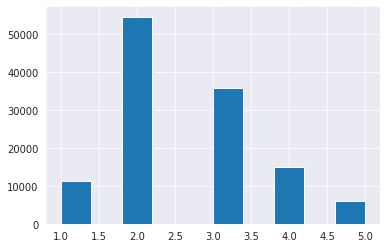

In [ ]:
# Now we will perform stratified sampling
# we will divide the data into groups according to diameter
# so that we can split the dataset into train and test samples such that both the samples have equal proportions of all groups

df['diameter_grp'] = pd.cut(df['diameter'],
                            bins=[0., 2., 4., 6., 8., np.inf], # diameter values 0-4 in grp 1, 4-8 in grp 2, etc. 
                            labels=[1, 2, 3, 4, 5]) # name of groups

df["diameter_grp"].hist() # shows the number of samples in each diameter group

In [ ]:
split = StratifiedShuffleSplit(test_size=0.2, random_state=1)
# Lets go with a smaller test size as we have a lot of data

for train_index, test_index in split.split(df, df['diameter_grp']):
    dftrain = df.loc[train_index]
    dftest =  df.loc[test_index]

dftrain.pop("level_0")
dftrain.pop("index")
dftest.pop("level_0")
dftest.pop("index")

# Creating a target Dataset
ytrain = dftrain.pop('diameter')
ytest = dftest.pop('diameter')

In [ ]:
df['diameter_grp'].value_counts() / len(df) 
# proprtions of each group in original dataset

2    0.445075
3    0.292933
4    0.121087
1    0.091977
5    0.048928
Name: diameter_grp, dtype: float64

In [ ]:
dftrain['diameter_grp'].value_counts() / len(dftrain) 
# proprtions of each group in splitted dataset
# As you can see, the proportions from original dataset are almost equal to the splitted dataset.

2    0.445069
3    0.292936
4    0.121089
1    0.091980
5    0.048926
Name: diameter_grp, dtype: float64

In [ ]:
# Now that we have splitted the data proportionally, we no longer need diameter_grp column
# If we keep it, it may interfere with the training of the model

for set_ in(dftrain, dftest):
    set_.drop("diameter_grp", axis=1, inplace=True)
dftrain.head()

,a,e,i,om,w,q,ad,per_y,condition_code,n_obs_used,H,albedo,moid,n,per,ma,pha_N,pha_Y,neo_N,neo_Y
29226,2.44032,0.22540,17.70330,109.57300,212.29540,1.89026,2.99038,3.81223,0.0,1419.0,13.7,0.187,0.89465,0.25854,1392.41619,29.11343,1,0,1,0
18196,2.50729,0.08986,9.20797,279.53359,32.84035,2.28198,2.73259,3.97021,0.0,779.0,15.0,0.202,1.27199,0.24826,1450.12049,299.38941,1,0,1,0
16742,2.29099,0.10121,9.06390,339.60586,250.91130,2.05911,2.52287,3.46771,0.0,624.0,15.8,0.079,1.07089,0.28423,1266.58250,241.35081,1,0,1,0
49500,2.73189,0.18250,23.30893,199.30877,90.58770,2.23331,3.23046,4.51546,0.0,661.0,15.3,0.326,1.36017,0.21828,1649.27223,34.17502,1,0,1,0
92043,2.62313,0.13023,13.76489,213.90547,142.74603,2.28152,2.96474,4.24852,0.0,245.0,16.3,0.070,1.29377,0.23199,1551.77307,200.07184,1,0,1,0


In [ ]:
#  Creating scaled datasets

# It is suggested to scale data before using Lasso
scale = MinMaxScaler()
sdftrain = scale.fit_transform(dftrain)
sdftest = scale.fit_transform(dftest)
sdftrain # All the values now lie between 0 to 1

array([[0.49048984, 0.15172738, 0.22500543, ..., 0.05708164, 0.38197459,
        0.30198311],
       [0.38553688, 0.1199096 , 0.22433584, ..., 0.08807703, 0.27921154,
        0.70509524],
       [0.31267798, 0.1118321 , 0.04699489, ..., 0.12098725, 0.21372918,
        0.41483877],
       ...,
       [0.39775749, 0.22167278, 0.18150202, ..., 0.08366151, 0.29067936,
        0.97733438],
       [0.34767865, 0.14314642, 0.05243965, ..., 0.10359642, 0.2445587 ,
        0.4919245 ],
       [0.39305243, 0.01096393, 0.0553677 , ..., 0.08532682, 0.28624806,
        0.76176858]])

##📊Interactive Seaborn Widget

In [ ]:
# This widget helped me a lot to find relation between variables and detect Outliers
# Open in jupyter notebook or colab, as you cannot access this in git
from ipywidgets import interactive
def size_widget(height=5.5, aspect=2.5, Y='diameter', X='ma', Kind='scatter'):
    sns.pairplot(df, palette='RdYlBu', hue=None, x_vars=X, y_vars=Y, height=height, aspect=aspect, kind=Kind) #hue='didameter_grp'

- Y: Column to plot on Y-axis
- X: Column to plot on X-axis
- Kind: Type of graph (kde will take time to load)

In [ ]:
interactive(size_widget, X = columns, Y= columns,  height=(3, 10, 0.25), aspect=(0.6, 2.5, 0.5), Kind=['scatter','hist','reg','kde'])

interactive(children=(FloatSlider(value=5.5, description='height', max=10.0, min=3.0, step=0.25), FloatSlider(…

# 🤖Implementing ML models

<h3 align="center"><B>Linear Regression</B></h3>

In [ ]:
# Scaled data not used since it fails in Linear Regression
model = LinearRegression()
model.fit(dftrain, ytrain)
pred = model.predict(dftest)
pred

array([15.74553638, 23.9511359 , 33.49711578, ..., 21.27304556,
       21.44163091,  6.42846593])

*Performace metrics*

In [ ]:
# Low Performance may be because none of the variables in the dataset share a linear relationship with diameter
linearMSE = mean_squared_error(pred,ytest)
linearRMSE = mean_squared_error(pred,ytest, squared=False)
linearMAE = mean_absolute_error(pred, ytest)
print(linearMSE)
print(linearRMSE)
print(linearMAE)


175.66093311569216
13.253713936693071
8.43612876253584


<h3 align="center"><B>Lasso</B></h3>

In [ ]:
# Lasso on unscaled data
# Unscaled data produces negative predictions
model = Lasso()
model.fit(dftrain, ytrain)
pred = model.predict(dftest)
pred

array([17.95047925, 22.61377044, 43.53863178, ..., 16.97706911,
       20.70715364,  2.7395412 ])

In [ ]:
Lasso_unscaledMSE = mean_squared_error(pred,ytest)
# Unscaled data is giving less error
Lasso_unscaledRMSE = mean_squared_error(pred,ytest, squared=False) 
Lasso_unscaledMAE = mean_absolute_error(pred, ytest)
print(Lasso_unscaledMSE)
print(Lasso_unscaledRMSE)
print(Lasso_unscaledMAE)

194.45647188457013
13.944765035115154
8.796108152993838


In [ ]:
# Lasso on scaled data
# Scaled data eliminates negative predictions in Lasso 
model = Lasso()
model.fit(sdftrain, ytrain)
pred = model.predict(sdftest)
pred  

array([12.89661993, 13.03221715, 35.66141302, ..., 10.10657318,
       27.23681531, 12.1145331 ])

In [ ]:
Lasso_scaledMSE = mean_squared_error(pred,ytest)
# Scaled data giving higher error
Lasso_scaledRMSE = mean_squared_error(pred,ytest, squared=False) 
print(Lasso_scaledMSE)
print(Lasso_scaledRMSE)

292.8020865057817
17.111460677153826


- Inference: Lasso performs better on unscaled data

<h3 align="center"><B>Ridge</B></h3>

In [ ]:
model = Ridge()
model.fit(dftrain, ytrain)
pred = model.predict(dftest)
pred

array([15.64498367, 23.7297116 , 33.06924446, ..., 21.00340326,
       21.71016074,  6.67615006])

In [ ]:
RidgeMSE = mean_squared_error(pred, ytest)
RidgeRMSE = mean_squared_error(pred, ytest, squared=False)
RidgeMAE = mean_absolute_error(pred, ytest)
print(RidgeMSE)
print(RidgeRMSE)
print(RidgeMAE)

175.25074187551698
13.238230315095631
8.414708181925345


<h3 align="center"><B>Decision Tree</B></h3>

In [ ]:
model = DecisionTreeRegressor(random_state=0, max_depth= 4)
model.fit(dftrain, ytrain)
pred = model.predict(dftest)
pred

array([ 8.47870779, 16.20717735, 26.52348062, ...,  6.93116885,
        8.47870779,  6.93116885])

In [ ]:
# Visualizing our decision tree
# Requires dtreeviz to be installed on your pc 
# Commented out to prevent interuption 
# Else you can find the visualization in the README.md file

#from dtreeviz.trees import *
#from IPython.display import Image, display_svg, SVG
#columns=['a', 'e', 'i', 'om', 'w', 'q', 'ad', 'per_y', 'data_arc', 'n_obs_used', 'H', 'albedo', 'rot_per', 'moid','n', 'per', 'ma']

#viz = dtreeviz(model, sdftrain, ytrain, feature_names=columns, target_name='diameter')
#viz.save("decision_tree.svg")
#viz

*We previously saw that H showed a clear negative trend with respect to diameter*</br>
*In the above visualization of the decision tree we can see that H is the variable used in most of the nodes*

In [ ]:
Decision_treeMSE = mean_squared_error(pred, ytest)
Decision_treeRMSE = mean_squared_error(pred, ytest, squared=False)
Decision_treeMAE = mean_absolute_error(pred, ytest)
print(Decision_treeMSE)
print(Decision_treeRMSE)
print(Decision_treeMAE)

30.6590125561964
5.537058113853998
2.9915500929828727


- I also tried Cost-complexity-pruning on Decision Tree but it didn't seem to have any special effect.  
[Click to know more](https://scikit-learn.org/stable/auto_examples/tree/plot_cost_complexity_pruning.html) <br>

<h3 align="center"><B>Random Forest</B></h3>

In [ ]:
model = RandomForestRegressor(random_state=0, max_depth=10)
model.fit(dftrain, ytrain)
pred = model.predict(dftest)
pred

array([ 9.22228031, 14.74881878, 17.14611237, ..., 12.98454231,
        7.37731318,  7.05059384])

In [ ]:
RandomForestMSE = mean_squared_error(pred, ytest)
RandomForestRMSE = mean_squared_error(pred, ytest, squared=False)
RandomForestMAE = mean_absolute_error(pred, ytest)
print(RandomForestMSE)
print(RandomForestRMSE)
print(RandomForestMAE)

10.400693143315879
3.2250105648378704
1.178764860364035


<h3 align="center"><B>Random Forest with Hyperparameter Tuning</B></h3>

In [ ]:
# Parameter grid that we will use to tune RandomForest

n_estimators = [int(x) for x in np.linspace(start = 10, stop = 80, num = 10)]
max_features = ['auto', 'sqrt']
max_depth = [2,4]
min_samples_split = [2, 5]
min_samples_leaf = [1, 2]
bootstrap = [True, False]

In [ ]:
param_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}

In [ ]:
# Running GridSearchCV to find the best parameters for our model

# Commented out for better performace while running the notebook
#rf_Model = RandomForestRegressor()
#from sklearn.model_selection import GridSearchCV
#rf_Grid = GridSearchCV(estimator = rf_Model, param_grid = param_grid, cv = 3, verbose=2, n_jobs = 4)
#rf_Grid.fit(sdftrain, ytrain)
#rf_Grid.best_params_

In [ ]:
model = RandomForestRegressor(bootstrap=True, max_depth=4, max_features = 'auto', min_samples_leaf=2, min_samples_split=5, n_estimators=25, random_state=1)
model.fit(dftrain, ytrain)
pred = model.predict(dftest)
pred

array([ 9.00015085, 11.93338245, 22.67549958, ...,  9.13104636,
        9.00015085,  5.8478923 ])

In [ ]:
RandomForest_hyperMSE = mean_squared_error(pred, ytest)
# This model offers performance similar to the one without Hyperparameter optimization
RandomForest_hyperRMSE = mean_squared_error(pred, ytest, squared=False)
RandomForest_hyperMAE = mean_absolute_error(pred, ytest)
print(RandomForest_hyperMSE)
print(RandomForest_hyperRMSE)
print(RandomForest_hyperMAE)

17.28743048410192
4.157815590439519
2.292163022281441


<h3 align="center"><B>Support Vector Regressor</B></h3>

In [ ]:
model = SVR()
model.fit(dftrain, ytrain)
pred = model.predict(dftest)
pred

array([ 8.87441747,  9.4193603 , 39.82507643, ...,  7.55984496,
       14.72158554,  5.06346433])

In [ ]:
svr_MSE = mean_squared_error(pred, ytest)
svr_RMSE = mean_squared_error(pred, ytest, squared=False)
svr_MAE = mean_absolute_error(pred, ytest)
print(svr_MSE)
print(svr_RMSE)
print(svr_MAE)

209.44214595420257
14.472116153286034
6.342710138962517


<h3 align="center"><B>KNN Regressor</B></h3>

In [ ]:
model = KNeighborsRegressor()
model.fit(sdftrain, ytrain)
pred = model.predict(sdftest)
pred

array([13.59  , 26.2858, 14.5602, ..., 14.593 , 15.6618, 12.2358])

In [ ]:
knn_MSE = mean_squared_error(pred, ytest)
knn_RMSE = mean_squared_error(pred, ytest, squared=False)
knn_MAE = mean_absolute_error(pred, ytest)
print(knn_MSE)
print(knn_RMSE)
print(knn_MAE)

190.45876224704753
13.800679774817164
7.484726388888888


<h3>KNN with log normalized values

In [ ]:
model = KNeighborsRegressor()
model.fit(xn_train, yn_train)
pred = model.predict(xn_test)
pred


array([3.099 , 2.6774, 7.3728, ..., 9.0006, 6.041 , 4.3424])

In [ ]:
knn_MSE = mean_squared_error(pred, yn_test)
knn_RMSE = mean_squared_error(pred, yn_test, squared=False)
knn_MAE = mean_absolute_error(pred, yn_test)
print(knn_MSE)
print(knn_RMSE)
print(knn_MAE)

3.719342739506371
1.9285597578261273
0.764189663491278


<h3 align="center"><B>XGBoost Regressor</B></h3>

In [ ]:
model = XGBRegressor(n_estimators=1000, max_depth=7, eta=0.1, subsample=0.7, colsample_bytree=0.8)
model.fit(dftrain, ytrain)
pred = model.predict(dftest)
pred

array([ 9.534056 , 14.767688 , 13.324388 , ..., 13.817564 ,  7.4006014,
        7.2259784], dtype=float32)

In [ ]:
xgb_MSE = mean_squared_error(pred, ytest)
xgb_RMSE = mean_squared_error(pred, ytest, squared=False)
xgb_MAE = mean_absolute_error(pred, ytest)
print(xgb_MSE)
print(xgb_RMSE)
print(xgb_MAE)

9.867930689883902
3.141326262883864
1.2129299725643274


## Hyperparameter tuning usin WandB sweeps🧹 
**Weights and biases is an MLOps tool for experiment tracking, visualization, and collaboration.**

> Using Wandb Sweeps for hyperparameter tuning gives you an edge over traditional tuning libraries like optuna. It provides you with a rich and interactive dashboard that features:
1. Inference of Parameter Importance through visualizations.
2. Parallel Coordinates Plot between hyperparameters and model metrics
3. Model performance history
4. Bayesian optimization featured in optuna
5. Tracking and viewing each batch of data used for training.
6. System performance metrics

**Check out the wandb page for this model:** https://wandb.ai/harsh-ajay-jadhav/Asteroid/sweeps/dqax0bbm?workspace=user-harsh-ajay-jadhav

In [ ]:
def train():

  config_defaults = {
      'max_depth': 4, 
      'colsample_bytree': 0.8,
      'n_estimators': 500,
      'eta': 0.1,
      'gamma': 0.2
  }
  # Start W&B
  wandb.init(config=config_defaults)
  config = wandb.config

  diff_df1 = diff_df.copy()
  y_diff = diff_df1.pop('diameter')
  xdiff_train, xdiff_test, ydiff_train, ydiff_test = train_test_split(diff_df1, y_diff, shuffle=True, random_state=21)

  # model = XGBRegressor(n_estimators=1000, max_depth=7, eta=0.1, subsample=0.7, colsample_bytree=0.8)
  model = XGBRegressor(n_estimators=config.n_estimators, max_depth=config.max_depth, eta=config.eta, subsample=1, colsample_bytree=config.colsample_bytree, gamma=config.gamma)
  model.fit(xdiff_train, ydiff_train)
  pred = model.predict(xdiff_test)

  xgb_MSE = mean_squared_error(pred, ydiff_test)
  xgb_RMSE = mean_squared_error(pred, ydiff_test, squared=False)
  xgb_MAE = mean_absolute_error(pred, ydiff_test)
  print(f"MAE: {round(xgb_MAE, 4)}, MSE: {round(xgb_MSE, 4)}, RMSE: {round(xgb_RMSE, 4)}")

  wandb.log({"mae": xgb_MAE, "mse": xgb_MSE, "rmse": xgb_RMSE})


In [ ]:
sweep_configs = {
    "method": "bayes", # ["grid", "random", "bayes"]
    "metric": {
        "name": "mse",
        "goal": "minimize"
    },
    "parameters": {
        "max_depth": {
            "values": [4, 6, 8, 10]
        },
        "colsample_bytree": {
            "values": [0.3, 0.5, 0.7, 0.9]
        },
        "n_estimators": {
            "values": [100, 500]
        },
        "eta": {
            "values": [0.1, 0.2, 0.3]
        },
        "gamma": {
            "values": [0, 0.2, 0.4]
        }
    }
}

In [ ]:
sweep_id = wandb.sweep(sweep=sweep_configs, project="Asteroid", entity = 'harsh-ajay-jadhav')

Create sweep with ID: dqax0bbm
Sweep URL: https://wandb.ai/harsh-ajay-jadhav/Asteroid/sweeps/dqax0bbm


In [ ]:
wandb.agent(sweep_id, function=train, count=60)

wandb: Agent Starting Run: 2y47ie5q with config:
wandb: 	colsample_bytree: 0.7
wandb: 	eta: 0.2
wandb: 	gamma: 0.4
wandb: 	max_depth: 6
wandb: 	n_estimators: 500


MAE: 0.9793, MSE: 4.427, RMSE: 2.1041


mae,▁
mse,▁
rmse,▁
mae,0.9793
mse,4.42704
rmse,2.10405


wandb: Agent Starting Run: 3erd8pd5 with config:
wandb: 	colsample_bytree: 0.9
wandb: 	eta: 0.3
wandb: 	gamma: 0.4
wandb: 	max_depth: 6
wandb: 	n_estimators: 100


MAE: 0.9931, MSE: 4.3658, RMSE: 2.0895


mae,▁
mse,▁
rmse,▁
mae,0.99307
mse,4.36581
rmse,2.08945


wandb: Agent Starting Run: h2ag9ena with config:
wandb: 	colsample_bytree: 0.9
wandb: 	eta: 0.3
wandb: 	gamma: 0.4
wandb: 	max_depth: 6
wandb: 	n_estimators: 100


MAE: 0.9931, MSE: 4.3658, RMSE: 2.0895


mae,▁
mse,▁
rmse,▁
mae,0.99307
mse,4.36581
rmse,2.08945


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: fo6qkvch with config:
wandb: 	colsample_bytree: 0.9
wandb: 	eta: 0.3
wandb: 	gamma: 0.4
wandb: 	max_depth: 8
wandb: 	n_estimators: 100


MAE: 0.97, MSE: 4.3122, RMSE: 2.0766


mae,▁
mse,▁
rmse,▁
mae,0.97004
mse,4.31219
rmse,2.07658


wandb: Agent Starting Run: j9sc9pzo with config:
wandb: 	colsample_bytree: 0.9
wandb: 	eta: 0.3
wandb: 	gamma: 0.4
wandb: 	max_depth: 10
wandb: 	n_estimators: 500


MAE: 0.9993, MSE: 7.2987, RMSE: 2.7016


mae,▁
mse,▁
rmse,▁
mae,0.99925
mse,7.29873
rmse,2.70162


wandb: Agent Starting Run: 9ehf4y4p with config:
wandb: 	colsample_bytree: 0.9
wandb: 	eta: 0.3
wandb: 	gamma: 0.4
wandb: 	max_depth: 8
wandb: 	n_estimators: 100


MAE: 0.97, MSE: 4.3122, RMSE: 2.0766


mae,▁
mse,▁
rmse,▁
mae,0.97004
mse,4.31219
rmse,2.07658


wandb: Agent Starting Run: wt6t9mg9 with config:
wandb: 	colsample_bytree: 0.9
wandb: 	eta: 0.3
wandb: 	gamma: 0.4
wandb: 	max_depth: 8
wandb: 	n_estimators: 100


MAE: 0.97, MSE: 4.3122, RMSE: 2.0766


mae,▁
mse,▁
rmse,▁
mae,0.97004
mse,4.31219
rmse,2.07658


wandb: Agent Starting Run: q1z55hu1 with config:
wandb: 	colsample_bytree: 0.9
wandb: 	eta: 0.3
wandb: 	gamma: 0.4
wandb: 	max_depth: 6
wandb: 	n_estimators: 100


MAE: 0.9931, MSE: 4.3658, RMSE: 2.0895


mae,▁
mse,▁
rmse,▁
mae,0.99307
mse,4.36581
rmse,2.08945


wandb: Agent Starting Run: w286ls8z with config:
wandb: 	colsample_bytree: 0.7
wandb: 	eta: 0.3
wandb: 	gamma: 0.4
wandb: 	max_depth: 8
wandb: 	n_estimators: 100


MAE: 0.9753, MSE: 3.9979, RMSE: 1.9995


mae,▁
mse,▁
rmse,▁
mae,0.9753
mse,3.9979
rmse,1.99948


wandb: Agent Starting Run: deelpvos with config:
wandb: 	colsample_bytree: 0.9
wandb: 	eta: 0.3
wandb: 	gamma: 0.4
wandb: 	max_depth: 10
wandb: 	n_estimators: 100


MAE: 0.9813, MSE: 7.1352, RMSE: 2.6712


mae,▁
mse,▁
rmse,▁
mae,0.9813
mse,7.13521
rmse,2.67118


wandb: Agent Starting Run: p1n0escw with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0
wandb: 	max_depth: 6
wandb: 	n_estimators: 500


MAE: 1.0296, MSE: 4.3466, RMSE: 2.0848


mae,▁
mse,▁
rmse,▁
mae,1.0296
mse,4.34657
rmse,2.08484


wandb: Agent Starting Run: y91g601r with config:
wandb: 	colsample_bytree: 0.5
wandb: 	eta: 0.3
wandb: 	gamma: 0
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0028, MSE: 5.9406, RMSE: 2.4373


mae,▁
mse,▁
rmse,▁
mae,1.00283
mse,5.94055
rmse,2.43732


wandb: Agent Starting Run: trd3oysu with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.1
wandb: 	gamma: 0.2
wandb: 	max_depth: 6
wandb: 	n_estimators: 100


MAE: 1.0388, MSE: 4.203, RMSE: 2.0501


mae,▁
mse,▁
rmse,▁
mae,1.03882
mse,4.20304
rmse,2.05013


wandb: Agent Starting Run: 620fctcy with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.1
wandb: 	gamma: 0.2
wandb: 	max_depth: 8
wandb: 	n_estimators: 100


MAE: 1.0208, MSE: 3.9366, RMSE: 1.9841


mae,▁
mse,▁
rmse,▁
mae,1.02076
mse,3.93658
rmse,1.98408


wandb: Agent Starting Run: yb9v52qy with config:
wandb: 	colsample_bytree: 0.5
wandb: 	eta: 0.2
wandb: 	gamma: 0.4
wandb: 	max_depth: 6
wandb: 	n_estimators: 100


MAE: 0.996, MSE: 7.359, RMSE: 2.7128


mae,▁
mse,▁
rmse,▁
mae,0.99602
mse,7.35902
rmse,2.71275


wandb: Agent Starting Run: 8dodowry with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.2
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0326, MSE: 3.7486, RMSE: 1.9361


mae,▁
mse,▁
rmse,▁
mae,1.03263
mse,3.74865
rmse,1.93614


wandb: Agent Starting Run: flc0efpp with config:
wandb: 	colsample_bytree: 0.9
wandb: 	eta: 0.3
wandb: 	gamma: 0.4
wandb: 	max_depth: 8
wandb: 	n_estimators: 100


MAE: 0.97, MSE: 4.3122, RMSE: 2.0766


mae,▁
mse,▁
rmse,▁
mae,0.97004
mse,4.31219
rmse,2.07658


wandb: Agent Starting Run: 8g34f6hz with config:
wandb: 	colsample_bytree: 0.5
wandb: 	eta: 0.2
wandb: 	gamma: 0.4
wandb: 	max_depth: 10
wandb: 	n_estimators: 100


MAE: 0.9736, MSE: 6.2283, RMSE: 2.4957


mae,▁
mse,▁
rmse,▁
mae,0.97356
mse,6.22832
rmse,2.49566


wandb: Agent Starting Run: i2mu776u with config:
wandb: 	colsample_bytree: 0.5
wandb: 	eta: 0.2
wandb: 	gamma: 0.4
wandb: 	max_depth: 10
wandb: 	n_estimators: 100


MAE: 0.9736, MSE: 6.2283, RMSE: 2.4957


mae,▁
mse,▁
rmse,▁
mae,0.97356
mse,6.22832
rmse,2.49566


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: vlmmahh6 with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.2
wandb: 	gamma: 0.2
wandb: 	max_depth: 6
wandb: 	n_estimators: 100


MAE: 1.0086, MSE: 3.2449, RMSE: 1.8014


mae,▁
mse,▁
rmse,▁
mae,1.00856
mse,3.24495
rmse,1.80137


wandb: Agent Starting Run: 71lz1xuj with config:
wandb: 	colsample_bytree: 0.5
wandb: 	eta: 0.1
wandb: 	gamma: 0.4
wandb: 	max_depth: 8
wandb: 	n_estimators: 100


MAE: 0.9717, MSE: 6.1474, RMSE: 2.4794


mae,▁
mse,▁
rmse,▁
mae,0.97169
mse,6.14737
rmse,2.47939


wandb: Agent Starting Run: 38xfcs4o with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.2
wandb: 	gamma: 0.4
wandb: 	max_depth: 6
wandb: 	n_estimators: 500


MAE: 1.0, MSE: 3.2962, RMSE: 1.8155


mae,▁
mse,▁
rmse,▁
mae,1.00001
mse,3.29616
rmse,1.81553


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 08woed0n with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.4
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0356, MSE: 3.7234, RMSE: 1.9296


mae,▁
mse,▁
rmse,▁
mae,1.03556
mse,3.72344
rmse,1.92962


wandb: Agent Starting Run: 45o8q3v6 with config:
wandb: 	colsample_bytree: 0.5
wandb: 	eta: 0.3
wandb: 	gamma: 0.2
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0036, MSE: 6.0123, RMSE: 2.452


mae,▁
mse,▁
rmse,▁
mae,1.0036
mse,6.01227
rmse,2.45199


wandb: Agent Starting Run: e53bzd3x with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.1
wandb: 	gamma: 0.2
wandb: 	max_depth: 8
wandb: 	n_estimators: 100


MAE: 1.0208, MSE: 3.9366, RMSE: 1.9841


mae,▁
mse,▁
rmse,▁
mae,1.02076
mse,3.93658
rmse,1.98408


wandb: Agent Starting Run: 19ezewhq with config:
wandb: 	colsample_bytree: 0.9
wandb: 	eta: 0.1
wandb: 	gamma: 0.2
wandb: 	max_depth: 8
wandb: 	n_estimators: 100


MAE: 0.9617, MSE: 4.6928, RMSE: 2.1663


mae,▁
mse,▁
rmse,▁
mae,0.96172
mse,4.6928
rmse,2.16629


wandb: Agent Starting Run: giczwt8d with config:
wandb: 	colsample_bytree: 0.5
wandb: 	eta: 0.1
wandb: 	gamma: 0.4
wandb: 	max_depth: 4
wandb: 	n_estimators: 500


MAE: 1.0118, MSE: 5.9523, RMSE: 2.4397


mae,▁
mse,▁
rmse,▁
mae,1.01182
mse,5.95233
rmse,2.43974


wandb: Agent Starting Run: zy718ymp with config:
wandb: 	colsample_bytree: 0.9
wandb: 	eta: 0.3
wandb: 	gamma: 0.4
wandb: 	max_depth: 4
wandb: 	n_estimators: 100


MAE: 1.0299, MSE: 4.3415, RMSE: 2.0836


mae,▁
mse,▁
rmse,▁
mae,1.0299
mse,4.34153
rmse,2.08363


wandb: Agent Starting Run: gnpz5i4w with config:
wandb: 	colsample_bytree: 0.9
wandb: 	eta: 0.3
wandb: 	gamma: 0
wandb: 	max_depth: 8
wandb: 	n_estimators: 100


MAE: 0.9704, MSE: 4.2749, RMSE: 2.0676


mae,▁
mse,▁
rmse,▁
mae,0.97045
mse,4.2749
rmse,2.06758


wandb: Agent Starting Run: qx9q5z5o with config:
wandb: 	colsample_bytree: 0.9
wandb: 	eta: 0.1
wandb: 	gamma: 0.4
wandb: 	max_depth: 8
wandb: 	n_estimators: 100


MAE: 0.9656, MSE: 5.0209, RMSE: 2.2407


mae,▁
mse,▁
rmse,▁
mae,0.96562
mse,5.02087
rmse,2.24073


wandb: Agent Starting Run: r05s2uyi with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.2
wandb: 	gamma: 0.2
wandb: 	max_depth: 8
wandb: 	n_estimators: 100


MAE: 1.008, MSE: 3.4994, RMSE: 1.8707


mae,▁
mse,▁
rmse,▁
mae,1.00799
mse,3.49938
rmse,1.87066


wandb: Agent Starting Run: njsvbkjz with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.2
wandb: 	max_depth: 8
wandb: 	n_estimators: 100


MAE: 1.0216, MSE: 3.7127, RMSE: 1.9268


mae,▁
mse,▁
rmse,▁
mae,1.02156
mse,3.71274
rmse,1.92685


wandb: Agent Starting Run: adllkgvp with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.2
wandb: 	max_depth: 8
wandb: 	n_estimators: 100


MAE: 1.0216, MSE: 3.7127, RMSE: 1.9268


mae,▁
mse,▁
rmse,▁
mae,1.02156
mse,3.71274
rmse,1.92685


wandb: Agent Starting Run: qyadhwth with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.4
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0356, MSE: 3.7234, RMSE: 1.9296


mae,▁
mse,▁
rmse,▁
mae,1.03556
mse,3.72344
rmse,1.92962


wandb: Agent Starting Run: utwhfkjv with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.4
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0356, MSE: 3.7234, RMSE: 1.9296


mae,▁
mse,▁
rmse,▁
mae,1.03556
mse,3.72344
rmse,1.92962


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: e5bexqdv with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.2
wandb: 	max_depth: 8
wandb: 	n_estimators: 100


MAE: 1.0216, MSE: 3.7127, RMSE: 1.9268


mae,▁
mse,▁
rmse,▁
mae,1.02156
mse,3.71274
rmse,1.92685


wandb: Agent Starting Run: vupoc1rh with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.2
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0326, MSE: 3.7486, RMSE: 1.9361


mae,▁
mse,▁
rmse,▁
mae,1.03263
mse,3.74865
rmse,1.93614


wandb: Agent Starting Run: z0xf2jgl with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.2
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0326, MSE: 3.7486, RMSE: 1.9361


mae,▁
mse,▁
rmse,▁
mae,1.03263
mse,3.74865
rmse,1.93614


wandb: Agent Starting Run: ixf86ovb with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.2
wandb: 	gamma: 0.4
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0024, MSE: 3.3857, RMSE: 1.84


mae,▁
mse,▁
rmse,▁
mae,1.0024
mse,3.38574
rmse,1.84004


wandb: Agent Starting Run: jjb5eqx1 with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.2
wandb: 	gamma: 0.2
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 0.9986, MSE: 3.4453, RMSE: 1.8562


mae,▁
mse,▁
rmse,▁
mae,0.99865
mse,3.44533
rmse,1.85616


wandb: Agent Starting Run: hv76wziz with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.2
wandb: 	gamma: 0.2
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 0.9986, MSE: 3.4453, RMSE: 1.8562


mae,▁
mse,▁
rmse,▁
mae,0.99865
mse,3.44533
rmse,1.85616


wandb: Agent Starting Run: 9dpfwoj4 with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.4
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0356, MSE: 3.7234, RMSE: 1.9296


mae,▁
mse,▁
rmse,▁
mae,1.03556
mse,3.72344
rmse,1.92962


wandb: Agent Starting Run: itomqrvg with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.2
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0326, MSE: 3.7486, RMSE: 1.9361


mae,▁
mse,▁
rmse,▁
mae,1.03263
mse,3.74865
rmse,1.93614


wandb: Agent Starting Run: mlsb7aaf with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.2
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0326, MSE: 3.7486, RMSE: 1.9361


mae,▁
mse,▁
rmse,▁
mae,1.03263
mse,3.74865
rmse,1.93614


wandb: Agent Starting Run: 4ti1pxf5 with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.4
wandb: 	max_depth: 10
wandb: 	n_estimators: 500


MAE: 1.0685, MSE: 4.0008, RMSE: 2.0002


mae,▁
mse,▁
rmse,▁
mae,1.0685
mse,4.00081
rmse,2.0002


wandb: Agent Starting Run: trcikyqi with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.4
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0356, MSE: 3.7234, RMSE: 1.9296


mae,▁
mse,▁
rmse,▁
mae,1.03556
mse,3.72344
rmse,1.92962


wandb: Agent Starting Run: pcyvxrwc with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.2
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0326, MSE: 3.7486, RMSE: 1.9361


mae,▁
mse,▁
rmse,▁
mae,1.03263
mse,3.74865
rmse,1.93614


wandb: Agent Starting Run: qg96obex with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.4
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0356, MSE: 3.7234, RMSE: 1.9296


mae,▁
mse,▁
rmse,▁
mae,1.03556
mse,3.72344
rmse,1.92962


wandb: Agent Starting Run: u82n81xu with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.2
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0326, MSE: 3.7486, RMSE: 1.9361


mae,▁
mse,▁
rmse,▁
mae,1.03263
mse,3.74865
rmse,1.93614


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: c5gkhqmw with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.4
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0356, MSE: 3.7234, RMSE: 1.9296


mae,▁
mse,▁
rmse,▁
mae,1.03556
mse,3.72344
rmse,1.92962


wandb: Agent Starting Run: 3d9gon0e with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.2
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0326, MSE: 3.7486, RMSE: 1.9361


mae,▁
mse,▁
rmse,▁
mae,1.03263
mse,3.74865
rmse,1.93614


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 7brqx8g5 with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.2
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0326, MSE: 3.7486, RMSE: 1.9361


mae,▁
mse,▁
rmse,▁
mae,1.03263
mse,3.74865
rmse,1.93614


wandb: Agent Starting Run: c1oak41a with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.2
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0326, MSE: 3.7486, RMSE: 1.9361


mae,▁
mse,▁
rmse,▁
mae,1.03263
mse,3.74865
rmse,1.93614


wandb: Agent Starting Run: semdjxoc with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.4
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0356, MSE: 3.7234, RMSE: 1.9296


mae,▁
mse,▁
rmse,▁
mae,1.03556
mse,3.72344
rmse,1.92962


wandb: Agent Starting Run: dex9gx8w with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.4
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0356, MSE: 3.7234, RMSE: 1.9296


mae,▁
mse,▁
rmse,▁
mae,1.03556
mse,3.72344
rmse,1.92962


wandb: Agent Starting Run: 3an2lmgq with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.2
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0326, MSE: 3.7486, RMSE: 1.9361


mae,▁
mse,▁
rmse,▁
mae,1.03263
mse,3.74865
rmse,1.93614


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: c2zz2hr2 with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.4
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0356, MSE: 3.7234, RMSE: 1.9296


mae,▁
mse,▁
rmse,▁
mae,1.03556
mse,3.72344
rmse,1.92962


wandb: Agent Starting Run: 7es90zz8 with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.2
wandb: 	gamma: 0.4
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0024, MSE: 3.3857, RMSE: 1.84


mae,▁
mse,▁
rmse,▁
mae,1.0024
mse,3.38574
rmse,1.84004


wandb: Agent Starting Run: mommmjmn with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.2
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0326, MSE: 3.7486, RMSE: 1.9361


mae,▁
mse,▁
rmse,▁
mae,1.03263
mse,3.74865
rmse,1.93614


wandb: Agent Starting Run: al8biub7 with config:
wandb: 	colsample_bytree: 0.3
wandb: 	eta: 0.3
wandb: 	gamma: 0.4
wandb: 	max_depth: 8
wandb: 	n_estimators: 500


MAE: 1.0356, MSE: 3.7234, RMSE: 1.9296


mae,▁
mse,▁
rmse,▁
mae,1.03556
mse,3.72344
rmse,1.92962


In [ ]:
diff_df1 = diff_df.copy()
y_diff = diff_df1.pop('diameter')
xdiff_train, xdiff_test, ydiff_train, ydiff_test = train_test_split(diff_df1, y_diff, shuffle=True, random_state=21)

# model = XGBRegressor(n_estimators=1000, max_depth=7, eta=0.1, subsample=0.7, colsample_bytree=0.8)
model = XGBRegressor(n_estimators=100, max_depth=6, eta=0.2, gamma=0.2, colsample_bytree=0.3)
model.fit(xdiff_train, ydiff_train)
pred = model.predict(xdiff_test)

xgb_MSE = mean_squared_error(pred, ydiff_test)
xgb_RMSE = mean_squared_error(pred, ydiff_test, squared=False)
xgb_MAE = mean_absolute_error(pred, ydiff_test)
print(f"MAE: {round(xgb_MAE, 4)}, MSE: {round(xgb_MSE, 4)}, RMSE: {round(xgb_RMSE, 4)}")

# No tuning
## MAE: 0.9868, MSE: 4.0826, RMSE: 2.0206

# After tuning
## MAE: 1.0086, MSE: 3.2449, RMSE: 1.8014

MAE: 1.0086, MSE: 3.2449, RMSE: 1.8014


###Parralel coordinate plot for XGBoost model
> <img src="https://i.ibb.co/Q6SVJWc/Untitled.png" 
     height="400" />

## Model Interpretation with Lime🍋
> LIME, the acronym for **local interpretable model-agnostic explanations**, is a technique that approximates any black box machine learning model with a local, interpretable model to explain each individual prediction.

> We used LIME on a model using the **added difficulty dataset** to understand what variables are considered in the prediction of diameter in the absence of important attributes like **H and albedo.**

In [ ]:
explainer = lime_tabular.LimeTabularExplainer(
    training_data=np.array(xdiff_train),
    feature_names=xdiff_train.columns,
    class_names=['diameter'],
    verbose=False,
    mode='regression'
)

In [ ]:
i = 25
exp = explainer.explain_instance(xdiff_test.iloc[47], model.predict, num_features=5)
exp.show_in_notebook(show_table=True)

In [ ]:
sp_exp = submodular_pick.SubmodularPick(explainer,
                                        np.array(xdiff_test),
                                        model.predict,
                                        sample_size=100, num_features=5, num_exps_desired=3)

In [ ]:
[exp.show_in_notebook() for exp in sp_exp.sp_explanations]
print('SP-LIME Explanations.')

SP-LIME Explanations.


> The model is using **orbital period** and **mean motion** of the body to predict its diameter. 

> The mean motion of a body represents the angular speed required by a body to complete one revolution around its orbit. It is dependent on mass of both the bodies (the asteroid and the sun), and the semi-major axis of the orbit. 

> *It is interesting to see how the model engineers a creative way to predict the diameters in the absence of important attributes like H and albedo that could be directly used to calculate the diameters.* 

# ☄️Comparing the Models

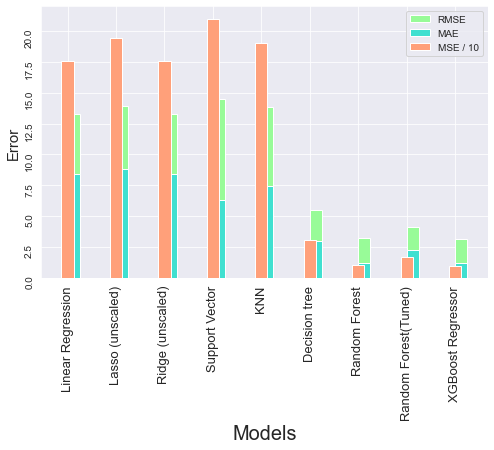

In [ ]:
models=['Linear Regression', 'Lasso (unscaled)', 'Ridge (unscaled)', 'Support Vector', 'KNN', 'Decision tree', 'Random Forest', 'Random Forest(Tuned)', 'XGBoost Regressor' ]
ValuesM=[linearMSE/10, Lasso_unscaledMSE/10, RidgeMSE/10, svr_MSE/10, knn_MSE/10, Decision_treeMSE/10, RandomForestMSE/10, RandomForest_hyperMSE/10, xgb_MSE/10]
ValuesR=[linearRMSE, Lasso_unscaledRMSE, RidgeRMSE, svr_RMSE, knn_RMSE, Decision_treeRMSE, RandomForestRMSE, RandomForest_hyperRMSE, xgb_RMSE]
ValuesA=[linearMAE, Lasso_unscaledMAE, RidgeMAE, svr_MAE, knn_MAE, Decision_treeMAE, RandomForestMAE, RandomForest_hyperMAE, xgb_MAE]
ypos = np.arange(len(models))

#size of graph
plt.figure(figsize=(8, 5))
#angle of x ticks
plt.xticks(rotation=90, fontsize=13)
plt.yticks(rotation=90, fontsize=10)
# Plotting RMSE
plt.bar(models, ValuesR, width=0.25, align='edge', color='palegreen', label = "RMSE")
# Plotting MAE
plt.bar(models, ValuesA, width=0.25, align='edge', color='turquoise', label = "MAE")
# Plotting MSE
plt.bar(models, ValuesM, width=0.25, color='lightsalmon', label="MSE / 10")
plt.xlabel("Models", fontsize = 20)
plt.ylabel("Error", fontsize= 15, rotation= 90)
plt.legend()

# MSE has been scaled down by a factor of 10